# Importing all the necessary libraries

In [78]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import cv2
import tensorflow as tf
import warnings
warnings.filterwarnings('ignore')

# PART - ONE

# Plant Seedling Classifier

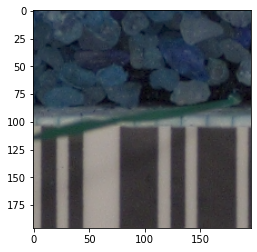

In [2]:
import glob
# train_directory = 'C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\train'
categories = glob.glob('C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\train\\*')
for category in categories:
    for images in os.listdir(category):
        img_array = cv2.imread(os.path.join(category,images),cv2.IMREAD_COLOR)
#         print(img_array)
        plt.imshow(img_array)
        plt.show()
        break
    break

In [3]:
img_array.shape

(196, 196, 3)

In [4]:
training_data = []

def create_training_data():
    categories = glob.glob('C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\train\\*')
    for category in categories:
        class_num = categories.index(category)
        for images in os.listdir(category):
            img_array = cv2.imread(os.path.join(category,images),cv2.IMREAD_COLOR)
            image_size = 196
            new_img_array = cv2.resize(img_array,(image_size,image_size))
            training_data.append([new_img_array,class_num])
            
create_training_data()

In [5]:
print(len(training_data))

4767


In [6]:
import random
random.shuffle(training_data)
image_size = 196

X = []
y = []

for features,label in training_data:
    X.append(features)
    y.append(label)

X = np.array(X).reshape(-1,image_size,image_size,3)
print('The shape of X after reshaping is:',X.shape)

The shape of X after reshaping is: (4767, 196, 196, 3)


In [7]:
import pickle

pickle_X = open("X_seedling.pickle","wb")
pickle.dump(X,pickle_X)
pickle_X.close()

pickle_Y = open("Y_seedling.pickle","wb")
pickle.dump(y,pickle_Y)
pickle_Y.close()

In [8]:
pickle_in = open("X_seedling.pickle","rb")
X = pickle.load(pickle_in)
print('The shape of X is: ',X.shape)

pickle_in = open("Y_seedling.pickle","rb")
y = pickle.load(pickle_in)
y = np.array(y).reshape(len(y),1)
print('The shape of y is: ',y.shape)

The shape of X is:  (4767, 196, 196, 3)
The shape of y is:  (4767, 1)


In [9]:
X = X.astype('float32') / 255
#Reshaping the data from 3D to 1D 
X_ = np.asarray(X).reshape(X.shape[0], X.shape[1]*X.shape[2]*X.shape[3])
y_ = y
y_ = tf.keras.utils.to_categorical(y, num_classes = 12)

## Plant Seedling Classifier - Using KNN

In [10]:
# Performing train/test split
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test = train_test_split(X_,y,test_size=0.25,random_state=42)

print('The shape of X_train is: ',X_train.shape)
print('The shape of y_train is: ',y_train.shape)
print('The shape of X_test is: ',X_test.shape)
print('The shape of y_test is: ',y_test.shape)

The shape of X_train is:  (3575, 115248)
The shape of y_train is:  (3575, 1)
The shape of X_test is:  (1192, 115248)
The shape of y_test is:  (1192, 1)


In [11]:
from sklearn.neighbors import KNeighborsClassifier
import time

StartTime = time.time()

model_knn = KNeighborsClassifier(n_neighbors=3,weights='distance')
model_knn = model_knn.fit(X_train,y_train)
    
y_pred = model_knn.predict(X_test)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

############### Total Time Taken:  19 Minutes #############


In [12]:
# Classification report
from sklearn import metrics
print(metrics.classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.31      0.23      0.26        71
           1       0.38      0.30      0.33        90
           2       0.74      0.17      0.28        80
           3       0.41      0.20      0.27       144
           4       0.17      0.30      0.21        53
           5       0.21      0.15      0.17       121
           6       0.34      0.37      0.36       179
           7       0.25      0.10      0.15        48
           8       0.18      0.66      0.29       121
           9       0.06      0.06      0.06        48
          10       0.41      0.27      0.32       132
          11       0.38      0.03      0.05       105

    accuracy                           0.26      1192
   macro avg       0.32      0.24      0.23      1192
weighted avg       0.33      0.26      0.25      1192



In [13]:
accuracy_knn_seedling = metrics.classification_report(y_test, y_pred).split()[-2]
accuracy_percentage_knn_seedling = float(accuracy_knn_seedling)*100

In [14]:
print('The Accuracy of seedling classifier using the K-NN model is :',accuracy_percentage_knn_seedling,'%')

The Accuracy of seedling classifier using the K-NN model is : 25.0 %


## Plant Seedling Classifier - Using Deep neural Networks

In [15]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.utils.np_utils import to_categorical
from keras.layers import Activation, Dense
from keras import optimizers

In [16]:
from keras import regularizers
#Initialize the Artificial Neural Network Classifier
seedling_model = Sequential()

seedling_model.add(Dense(512, kernel_initializer = 'he_normal',input_shape = (X_.shape[1], )))
#Adding Activation function
seedling_model.add(Activation('relu'))

#Hidden Layer 1
#Adding first Hidden layer of 256 nodes
seedling_model.add(Dense(256, kernel_initializer = 'he_normal'))
#Adding Activation function
seedling_model.add(Activation('relu'))

#Hidden Layer 2
#Adding first Hidden layer of 128 nodes
seedling_model.add(Dense(128, kernel_initializer = 'he_normal'))
#Adding Activation function
seedling_model.add(Activation('relu'))

#Hidden Layer 3
#Adding first Hidden layer of 64 nodes
seedling_model.add(Dense(64, kernel_initializer = 'he_normal'))
#Adding Activation function
seedling_model.add(Activation('relu'))

#Hidden Layer 4
#Adding first Hidden layer of 32 nodes
seedling_model.add(Dense(32, kernel_initializer = 'he_normal'))
#Adding Activation function
seedling_model.add(Activation('relu'))

# Output Layer
#Adding output layer which is of 12 nodes (digits)
seedling_model.add(Dense(12))
#Adding Activation function
# Here, we are using softmax function because we have multiclass classsification
seedling_model.add(Activation('softmax'))

print(seedling_model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 512)               59007488  
_________________________________________________________________
activation (Activation)      (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               131328    
_________________________________________________________________
activation_1 (Activation)    (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
activation_2 (Activation)    (None, 128)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 64)                8

In [17]:
# compiling the ANN classifier
adam = tf.keras.optimizers.Adam(lr=0.0001)
seedling_model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [18]:
# Fitting the ANN to the Training data
history = seedling_model.fit(X_, y_,batch_size = 256, epochs = 300, verbose = 1,validation_split=0.25)

Epoch 1/300
14/14 [==============================] - 298s 21s/step - loss: 33.8859 - accuracy: 0.0945 - val_loss: 25.7937 - val_accuracy: 0.0436
Epoch 2/300
14/14 [==============================] - 17s 1s/step - loss: 18.8246 - accuracy: 0.0917 - val_loss: 25.3763 - val_accuracy: 0.0940
Epoch 3/300
14/14 [==============================] - 16s 1s/step - loss: 14.1000 - accuracy: 0.0948 - val_loss: 6.4429 - val_accuracy: 0.0940
Epoch 4/300
14/14 [==============================] - 17s 1s/step - loss: 4.6264 - accuracy: 0.1183 - val_loss: 3.3533 - val_accuracy: 0.0621
Epoch 5/300
14/14 [==============================] - 17s 1s/step - loss: 2.7827 - accuracy: 0.1382 - val_loss: 2.5208 - val_accuracy: 0.1116
Epoch 6/300
14/14 [==============================] - 18s 1s/step - loss: 2.4006 - accuracy: 0.1656 - val_loss: 2.3069 - val_accuracy: 0.1468
Epoch 7/300
14/14 [==============================] - 18s 1s/step - loss: 2.2754 - accuracy: 0.1731 - val_loss: 2.2813 - val_accuracy: 0.2383
Epoch 

Epoch 58/300
14/14 [==============================] - 10s 685ms/step - loss: 1.3427 - accuracy: 0.5312 - val_loss: 1.6984 - val_accuracy: 0.4102
Epoch 59/300
14/14 [==============================] - 10s 704ms/step - loss: 1.2624 - accuracy: 0.5625 - val_loss: 1.6794 - val_accuracy: 0.3859
Epoch 60/300
14/14 [==============================] - 10s 690ms/step - loss: 1.3155 - accuracy: 0.5323 - val_loss: 1.6731 - val_accuracy: 0.4178
Epoch 61/300
14/14 [==============================] - 9s 678ms/step - loss: 1.4333 - accuracy: 0.4920 - val_loss: 2.0371 - val_accuracy: 0.3515
Epoch 62/300
14/14 [==============================] - 9s 678ms/step - loss: 1.4825 - accuracy: 0.4641 - val_loss: 1.6686 - val_accuracy: 0.4211
Epoch 63/300
14/14 [==============================] - 10s 679ms/step - loss: 1.2494 - accuracy: 0.5614 - val_loss: 1.5976 - val_accuracy: 0.4404
Epoch 64/300
14/14 [==============================] - 10s 684ms/step - loss: 1.2110 - accuracy: 0.5807 - val_loss: 1.7256 - val_accu

14/14 [==============================] - 10s 687ms/step - loss: 0.7892 - accuracy: 0.7309 - val_loss: 1.7023 - val_accuracy: 0.4572
Epoch 115/300
14/14 [==============================] - 10s 685ms/step - loss: 0.7319 - accuracy: 0.7471 - val_loss: 1.6833 - val_accuracy: 0.4690
Epoch 116/300
14/14 [==============================] - 10s 686ms/step - loss: 0.6572 - accuracy: 0.7866 - val_loss: 1.8607 - val_accuracy: 0.4404
Epoch 117/300
14/14 [==============================] - 9s 678ms/step - loss: 0.6489 - accuracy: 0.7883 - val_loss: 1.9234 - val_accuracy: 0.4404
Epoch 118/300
14/14 [==============================] - 9s 678ms/step - loss: 0.7531 - accuracy: 0.7323 - val_loss: 1.7984 - val_accuracy: 0.4404
Epoch 119/300
14/14 [==============================] - 9s 678ms/step - loss: 0.6822 - accuracy: 0.7796 - val_loss: 1.8586 - val_accuracy: 0.4228
Epoch 120/300
14/14 [==============================] - 9s 678ms/step - loss: 0.8109 - accuracy: 0.7032 - val_loss: 1.9469 - val_accuracy: 0.4

14/14 [==============================] - 9s 677ms/step - loss: 1.5437 - accuracy: 0.4557 - val_loss: 1.7365 - val_accuracy: 0.3733
Epoch 171/300
14/14 [==============================] - 9s 676ms/step - loss: 1.2921 - accuracy: 0.5379 - val_loss: 1.5964 - val_accuracy: 0.4262
Epoch 172/300
14/14 [==============================] - 9s 677ms/step - loss: 1.0252 - accuracy: 0.6324 - val_loss: 1.7523 - val_accuracy: 0.4237
Epoch 173/300
14/14 [==============================] - 9s 677ms/step - loss: 1.0833 - accuracy: 0.6028 - val_loss: 2.4349 - val_accuracy: 0.3079
Epoch 174/300
14/14 [==============================] - 10s 681ms/step - loss: 1.6523 - accuracy: 0.4414 - val_loss: 1.8558 - val_accuracy: 0.3591
Epoch 175/300
14/14 [==============================] - 10s 685ms/step - loss: 1.0445 - accuracy: 0.6378 - val_loss: 1.5423 - val_accuracy: 0.5000
Epoch 176/300
14/14 [==============================] - 10s 680ms/step - loss: 0.8222 - accuracy: 0.7443 - val_loss: 1.6802 - val_accuracy: 0.4

14/14 [==============================] - 9s 678ms/step - loss: 0.3255 - accuracy: 0.8971 - val_loss: 2.0691 - val_accuracy: 0.5000
Epoch 227/300
14/14 [==============================] - 10s 680ms/step - loss: 0.2422 - accuracy: 0.9368 - val_loss: 2.1207 - val_accuracy: 0.5025
Epoch 228/300
14/14 [==============================] - 10s 679ms/step - loss: 0.2589 - accuracy: 0.9267 - val_loss: 2.0990 - val_accuracy: 0.5076
Epoch 229/300
14/14 [==============================] - 10s 687ms/step - loss: 0.2560 - accuracy: 0.9278 - val_loss: 2.2543 - val_accuracy: 0.5034
Epoch 230/300
14/14 [==============================] - 10s 695ms/step - loss: 0.2167 - accuracy: 0.9452 - val_loss: 2.2757 - val_accuracy: 0.4849
Epoch 231/300
14/14 [==============================] - 9s 677ms/step - loss: 0.2502 - accuracy: 0.9236 - val_loss: 2.4615 - val_accuracy: 0.4715
Epoch 232/300
14/14 [==============================] - 9s 677ms/step - loss: 0.5349 - accuracy: 0.8145 - val_loss: 2.6429 - val_accuracy: 0.

14/14 [==============================] - 16s 1s/step - loss: 0.3323 - accuracy: 0.9116 - val_loss: 1.9290 - val_accuracy: 0.5034
Epoch 284/300
14/14 [==============================] - 19s 1s/step - loss: 0.2484 - accuracy: 0.9385 - val_loss: 2.0889 - val_accuracy: 0.4698
Epoch 285/300
14/14 [==============================] - 17s 1s/step - loss: 0.2481 - accuracy: 0.9354 - val_loss: 1.9933 - val_accuracy: 0.5159
Epoch 286/300
14/14 [==============================] - 16s 1s/step - loss: 0.3703 - accuracy: 0.8713 - val_loss: 2.2794 - val_accuracy: 0.4924
Epoch 287/300
14/14 [==============================] - 16s 1s/step - loss: 0.4180 - accuracy: 0.8545 - val_loss: 2.2080 - val_accuracy: 0.5109
Epoch 288/300
14/14 [==============================] - 18s 1s/step - loss: 0.5003 - accuracy: 0.8199 - val_loss: 2.1323 - val_accuracy: 0.4857
Epoch 289/300
14/14 [==============================] - 16s 1s/step - loss: 0.3212 - accuracy: 0.9027 - val_loss: 2.0699 - val_accuracy: 0.5000
Epoch 290/300

In [19]:
print('Validation accuracy using ANN for seedling classifier is : ', max(history.history['val_accuracy'])*100,'%')

Validation accuracy using ANN for seedling classifier is :  51.761746406555176 %


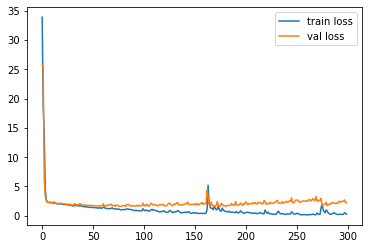

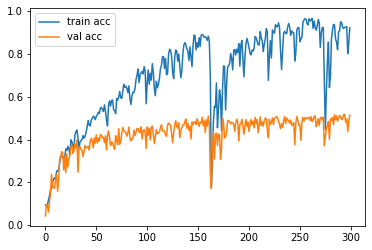

In [20]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [21]:
# save it as a pickle file
from tensorflow.keras.models import load_model
seedling_model.save('seedling_model.pkl')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: seedling_model.pkl\assets


## Plant Seedling Classifier Classifier - Using Convolutional Neural Networks

In [22]:
# Deep Learning CNN model to recognize face
'''This script uses a database of images and creates CNN model on top of it to test
   if the given image is recognized correctly or not'''

'''########################## IMAGE PRE-PROCESSING for TRAINING and TESTING data ##############################'''

TrainingImagePath='C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\train'
TestingImagePath='C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\test'

from keras.preprocessing.image import ImageDataGenerator

# Defining pre-processing transformations on raw images of training data
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        validation_split=0.25)

# Generating the Training Data
training_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(100, 100),
        batch_size=32,
        class_mode='categorical',
        subset='training')


# Generating the Testing Data
validation_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(100, 100),
        batch_size=32,
        class_mode='categorical',
        subset='validation')

# Printing class labels for each face
# test_set.class_indices

Found 3581 images belonging to 12 classes.
Found 1186 images belonging to 12 classes.


In [23]:
'''########################## IMAGE PRE-PROCESSING for TRAINING and TESTING data ##############################'''

TrainingImagePath='C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\train'
TestingImagePath='C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\test'

from keras.preprocessing.image import ImageDataGenerator

# Defining pre-processing transformations on raw images of training data
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        validation_split=0.25)

# Generating the Training Data
training_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(100, 100),
        batch_size=32,
        class_mode='categorical',
        subset='training')


# Generating the Validation Data
validation_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(100, 100),
        batch_size=32,
        class_mode='categorical',
        subset='validation')

# Printing class labels for each plant seedling
# test_set.class_indices

Found 3581 images belonging to 12 classes.
Found 1186 images belonging to 12 classes.


In [26]:
'''#################### Creating lookup table for all plant seedlings ##############################'''
# class_indices have the numeric tag for each plant seedling
TrainClasses=training_set.class_indices

# Storing the plant seedling and the numeric tag for future reference
ResultMap={}
for plant_seedlingValue,plant_seedlingName in zip(TrainClasses.values(),TrainClasses.keys()):
    ResultMap[plant_seedlingValue]=plant_seedlingName

# Saving the plant seedling map for future reference
import pickle
with open("C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\ResultsMap.pkl", 'wb') as f:
    pickle.dump(ResultMap, f, pickle.HIGHEST_PROTOCOL)

print("Mapping of Plant Seedling and its ID",ResultMap)

# The number of neurons for the output layer is equal to the number of plant seedlings
OutputNeurons=len(ResultMap)
print('\n The Number of output neurons: ', OutputNeurons)

Mapping of Plant Seedling and its ID {0: 'Black-grass', 1: 'Charlock', 2: 'Cleavers', 3: 'Common Chickweed', 4: 'Common wheat', 5: 'Fat Hen', 6: 'Loose Silky-bent', 7: 'Maize', 8: 'Scentless Mayweed', 9: 'Shepherds Purse', 10: 'Small-flowered Cranesbill', 11: 'Sugar beet'}

 The Number of output neurons:  12


In [29]:
'''######################## Create CNN deep learning model ####################################'''
from keras.models import Sequential
from keras.layers import Convolution2D
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense

'''Initializing the Convolutional Neural Network'''
seedling_classifier= Sequential()

''' STEP--1 Convolution
# Adding the first layer of CNN
# we are using the format (100,100,3) because we are using TensorFlow backend
# It means 3 matrix of size (100X100) pixels representing Red, Green and Blue components of pixels
'''
seedling_classifier.add(Convolution2D(32, kernel_size=(5, 5), strides=(1, 1), input_shape=(100,100,3), activation='relu'))

'''# STEP--2 MAX Pooling'''
seedling_classifier.add(MaxPool2D(pool_size=(2,2)))

'''############## ADDITIONAL LAYER of CONVOLUTION for better accuracy #################'''
seedling_classifier.add(Convolution2D(64, kernel_size=(5, 5), strides=(1, 1), activation='relu'))

seedling_classifier.add(MaxPool2D(pool_size=(2,2)))


'''# STEP--3 FLattening'''
seedling_classifier.add(Flatten())

'''# STEP--4 Fully Connected Neural Network'''
seedling_classifier.add(Dense(512, activation='relu'))

seedling_classifier.add(Dense(OutputNeurons, activation='softmax'))

'''# Compiling the CNN'''
#seedling_classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
seedling_classifier.compile(loss='categorical_crossentropy', optimizer = 'adam', metrics=["accuracy"])

In [30]:
import time
# Measuring the time taken by the model to train
StartTime=time.time()

# Starting the model training
history = seedling_classifier.fit_generator(
                    training_set,
                    steps_per_epoch=50,validation_data=validation_set,
                    epochs=30)

EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/30
50/50 [==============================] - 98s 2s/step - loss: 2.4280 - accuracy: 0.1509 - val_loss: 2.3265 - val_accuracy: 0.2251
Epoch 2/30
50/50 [==============================] - 97s 2s/step - loss: 1.9773 - accuracy: 0.3325 - val_loss: 1.6816 - val_accuracy: 0.4089
Epoch 3/30
50/50 [==============================] - 97s 2s/step - loss: 1.6252 - accuracy: 0.4356 - val_loss: 1.5214 - val_accuracy: 0.4890
Epoch 4/30
50/50 [==============================] - 99s 2s/step - loss: 1.5121 - accuracy: 0.4688 - val_loss: 1.4674 - val_accuracy: 0.4848
Epoch 5/30
50/50 [==============================] - 101s 2s/step - loss: 1.3891 - accuracy: 0.5191 - val_loss: 1.3017 - val_accuracy: 0.5523
Epoch 6/30
50/50 [==============================] - 100s 2s/step - loss: 1.2739 - accuracy: 0.5512 - val_loss: 1.1745 - val_accuracy: 0.5919
Epoch 7/30
50/50 [==============================] - 99s 2s/step - loss: 1.1493 - accuracy: 0.5900 - val_loss: 1.2206 - val_accuracy: 0.5944
Epoch 8/30
50/50 [

In [31]:
results = seedling_classifier.evaluate(validation_set)
print('Validation accuracy using CNN for seedling classifier is : ', results[1]*100,'%')

38/38 [==============================] - 17s 448ms/step - loss: 0.8331 - accuracy: 0.7530
Validation accuracy using CNN for seedling classifier is :  75.29510855674744 %


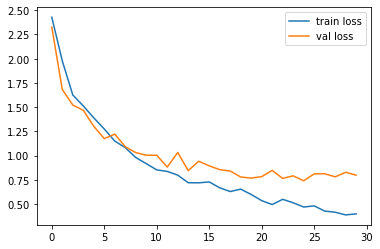

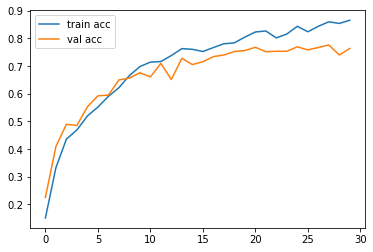

In [32]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [33]:
## Saving the model
seedling_classifier.save("C:/Users/admin/Great Learning/Computer Vision/Project/plant_seedling_classifier_cnn.pkl")

INFO:tensorflow:Assets written to: C:/Users/admin/Great Learning/Computer Vision/Project/plant_seedling_classifier_cnn.pkl\assets


INFO:tensorflow:Assets written to: C:/Users/admin/Great Learning/Computer Vision/Project/plant_seedling_classifier_cnn.pkl\assets


## Plant Seedling To Be Predicted
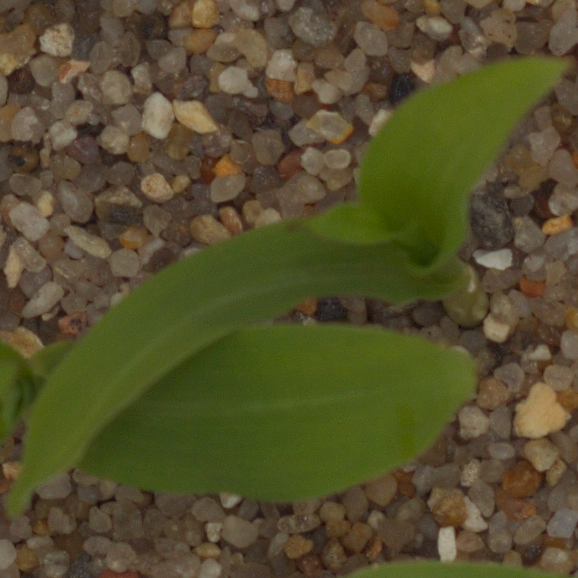

## We can clearly see from the accuracies that CNN perform better than DL and ML models. Hence, the CNN model has been chose as the best model here.

In [34]:
'''########################## Making single predictions ############################'''
import numpy as np
from keras.preprocessing import image

testImage='C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/Predict.png'
test_image=image.load_img(testImage,target_size=(100, 100))
test_image=image.img_to_array(test_image)

test_image=np.expand_dims(test_image,axis=0)

result=seedling_classifier.predict(test_image,verbose=0)
#print(training_set.class_indices)

print('####'*10)
print('Prediction is: ',ResultMap[np.argmax(result)])

########################################
Prediction is:  Maize


# ------------------------------------------------------------------------------------------------------------

# PART - TWO

### Q) TASK: Explain in depth why CNN out performs neural networks which in turn out perform supervised learning models when it comes to image classification. Use the markdown option in Jupiter for your answer.

### Answer : 
### Why DL Algorithms perform better than Supervised Learning Algorithms?
### a) Data dependencies : The most important difference between deep learning and traditional machine learning is its performance as the scale of data increases. When the data is small, deep learning algorithms don’t perform that well. This is because deep learning algorithms need a large amount of data to understand it perfectly. On the other hand, traditional machine learning algorithms with their handcrafted rules prevail in this scenario.
### b) Hardware Dependencies : Deep learning algorithms heavily depend on high-end machines, contrary to traditional machine learning algorithms, which can work on low-end machines. This is because the requirements of deep learning algorithm include GPUs which are an integral part of its working. Deep learning algorithms inherently do a large amount of matrix multiplication operations. These operations can be efficiently optimized using a GPU because GPU is built for this purpose.
### c) Execution Time : Usually, a deep learning algorithm takes a long time to train. This is because there are so many parameters in a deep learning algorithm that training them takes longer than usual. State of the art deep learning algorithm ResNet takes about two weeks to train completely from scratch. Whereas machine learning comparatively takes much less time to train, ranging from a few seconds to a few hours.This is turn is completely reversed on testing time. At test time, deep learning algorithm takes much less time to run. Whereas, if you compare it with k-nearest neighbors (a type of machine learning algorithm), test time increases on increasing the size of data. Although this is not applicable on all machine learning algorithms, as some of them have small testing times too.

### Why CNN is better than ANN for image classification?
### a) Converting images to a vector : While solving an image classification problem using ANN, the first step is to convert a 2-dimensional image into a 1-dimensional vector prior to training the model. This has two drawbacks:
###   i) The number of trainable parameters increases drastically with an increase in the size of the image.
###   ii) ANN loses the spatial features of an image. Spatial features refer to the arrangement of the pixels in an image.

# ------------------------------------------------------------------------------------------------------------

# PART - THREE

## Generation of Image data for 15 car images given

In [35]:
import os
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from glob import glob

datagen = ImageDataGenerator(
        rotation_range=38,
        width_shift_range=0.32,
        height_shift_range=0.2,
        shear_range=0.23,
        zoom_range=0.18,
        horizontal_flip=True,
        fill_mode='nearest')

img = load_img('C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images\\00001.jpg')  # this is a PIL image
x = img_to_array(img)  # this is a Numpy array with shape (400,600,3)
print(x.shape)
x = x.reshape((1,) + x.shape)  # this is a Numpy array with shape (1, 3, 400, 600)

images = glob('C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images\\*')
Images = []
for i in images:
    Images.append(i[-9:])
# print(Images)
car_names = []
for i in Images:
    car_names.append(i[:5])
print(car_names)

import time
StartTime = time.time()

for i in car_names:
    img = load_img('C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images\\' + i + '.jpg')  # this is a PIL image
    x = img_to_array(img)  # this is a Numpy array with shape (400,600,3)
#     print(x.shape)
    x = x.reshape((1,) + x.shape)
    directory = i
    parent_dir = "C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images"
    path = os.path.join(parent_dir, directory) 
    os.mkdir(path) 

    # the .flow() command below generates batches of randomly transformed images
    # and saves the results to the `preview/` directory
    j = 0
    for batch in datagen.flow(x, batch_size=1,
                              save_to_dir=path, save_prefix=j, save_format='jpeg'):
        j += 1
        if j > 9:
            break  # otherwise the generator would loop indefinitely
            
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

(400, 600, 3)
['00001', '00002', '00003', '00004', '00005', '00006', '00007', '00008', '00009', '00010', '00011', '00012', '00013', '00014', '00015']
############### Total Time Taken:  0 Minutes #############


## Files created for each of the car types, that contain the transformations implemented.
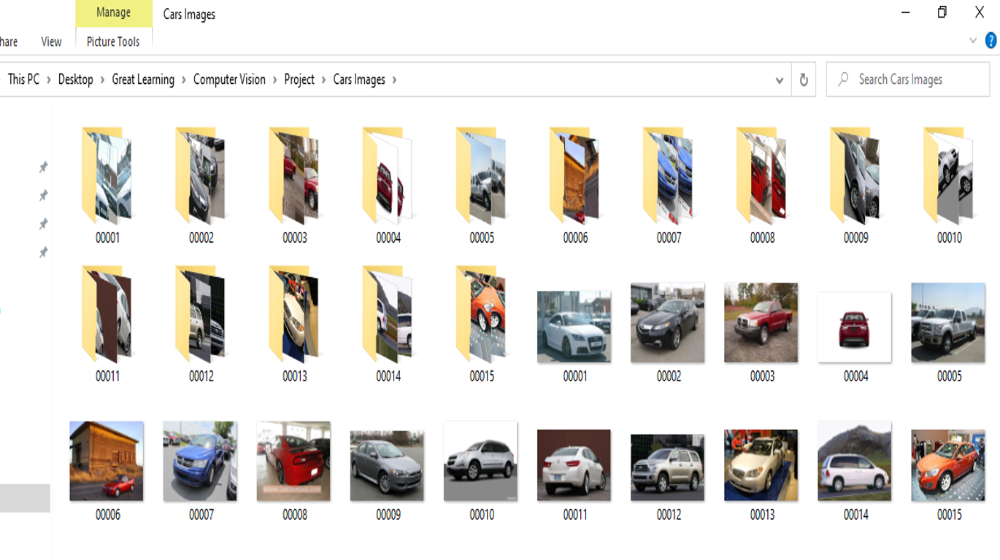

Car :  00001


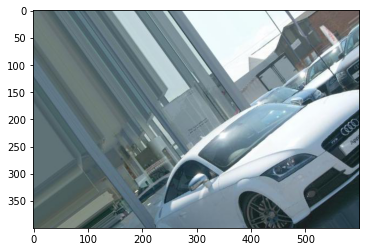

Car :  00001


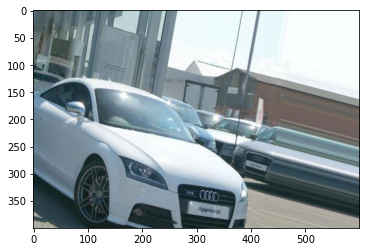

Car :  00001


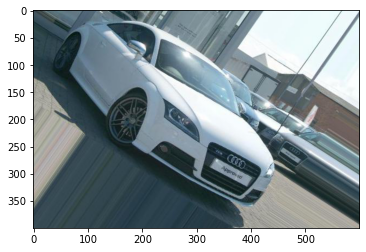

Car :  00001


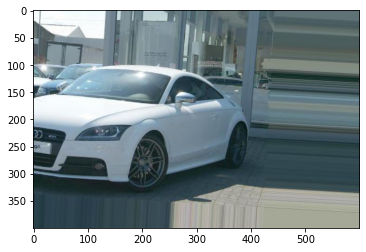

Car :  00001


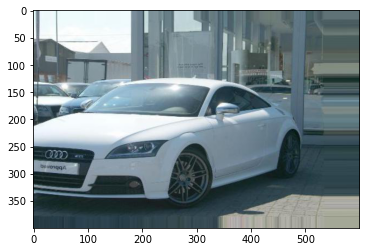

Car :  00001


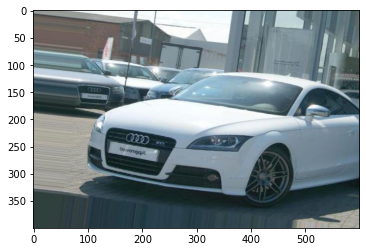

Car :  00001


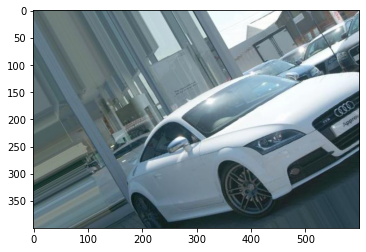

Car :  00001


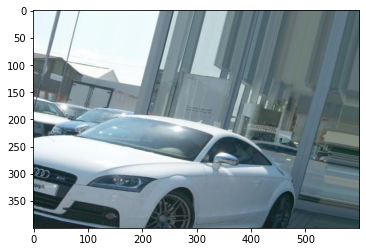

Car :  00001


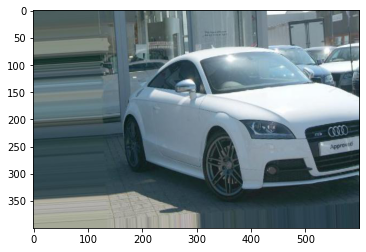

Car :  00001


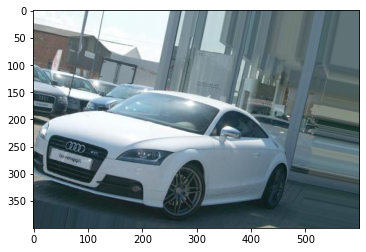

#######################################################################################################################
Car :  00002


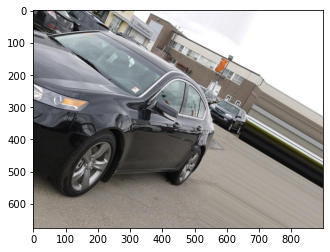

Car :  00002


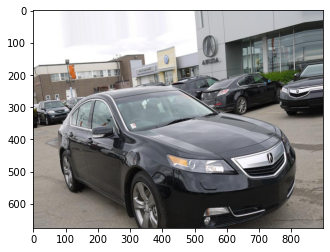

Car :  00002


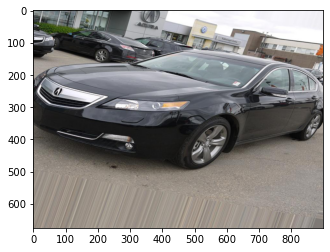

Car :  00002


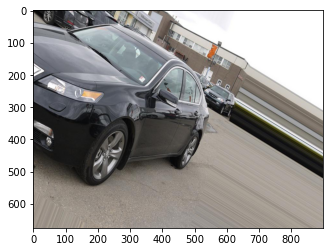

Car :  00002


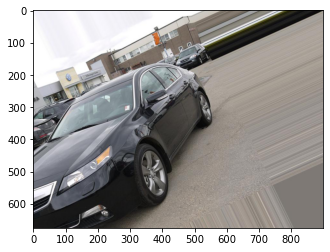

Car :  00002


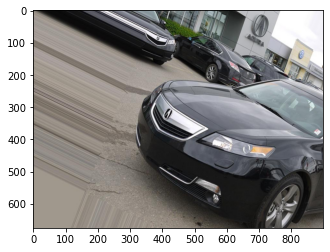

Car :  00002


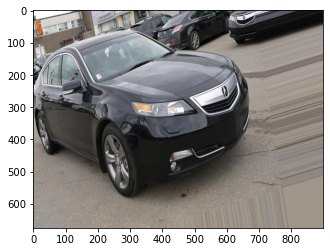

Car :  00002


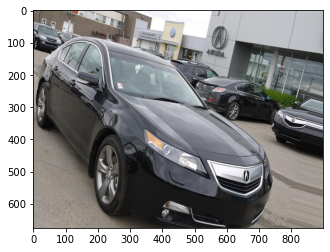

Car :  00002


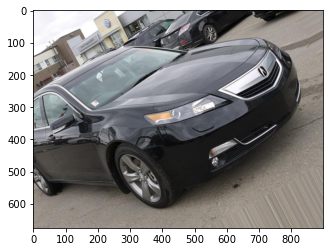

Car :  00002


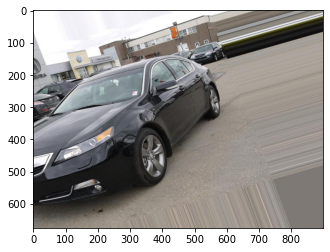

#######################################################################################################################
Car :  00003


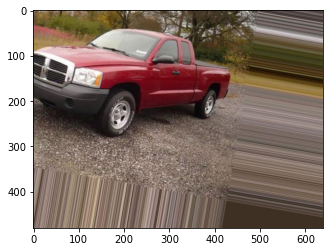

Car :  00003


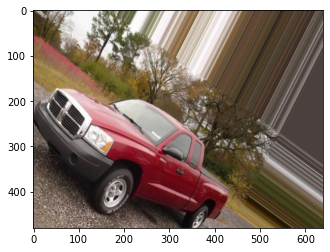

Car :  00003


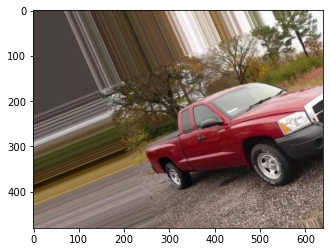

Car :  00003


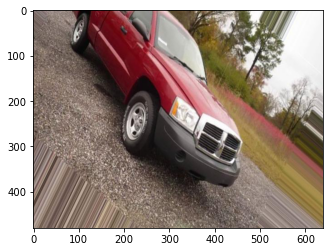

Car :  00003


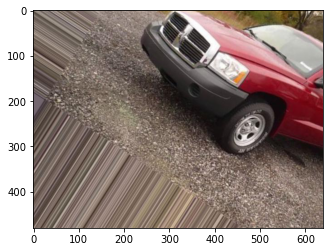

Car :  00003


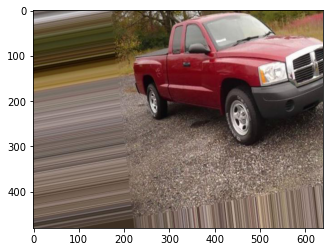

Car :  00003


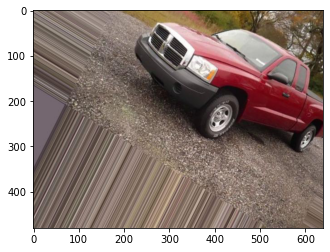

Car :  00003


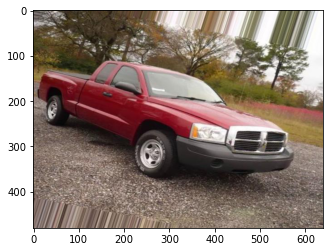

Car :  00003


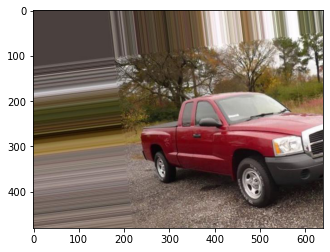

Car :  00003


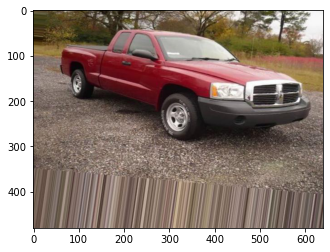

#######################################################################################################################
Car :  00004


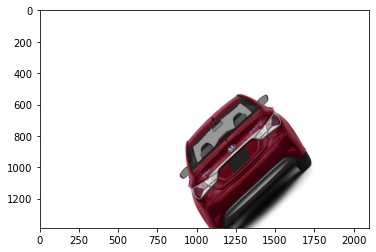

Car :  00004


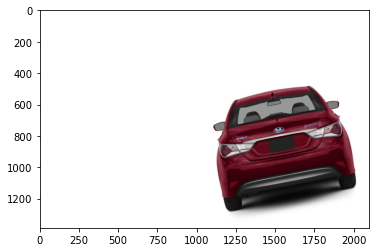

Car :  00004


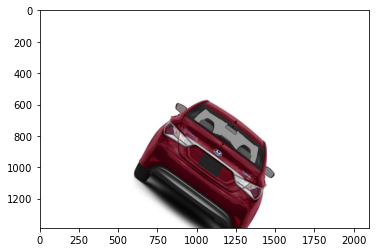

Car :  00004


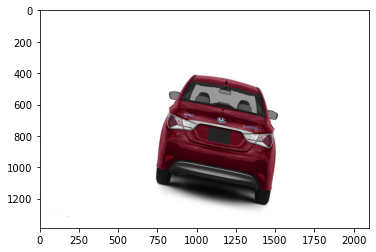

Car :  00004


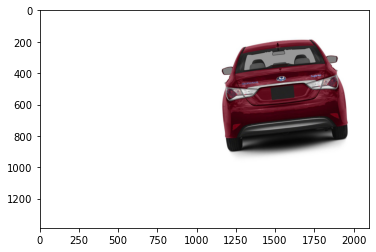

Car :  00004


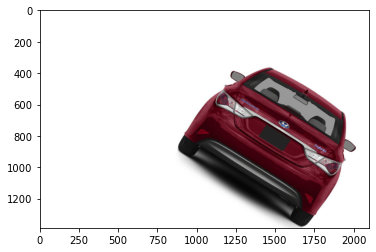

Car :  00004


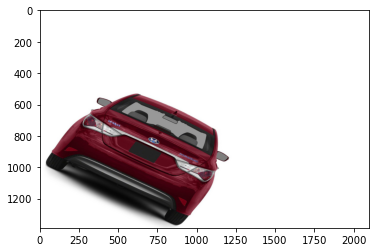

Car :  00004


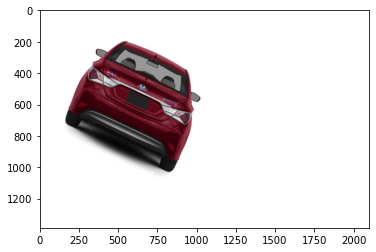

Car :  00004


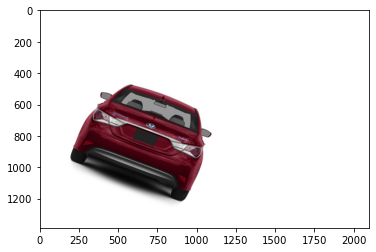

Car :  00004


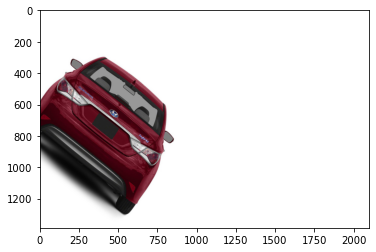

#######################################################################################################################
Car :  00005


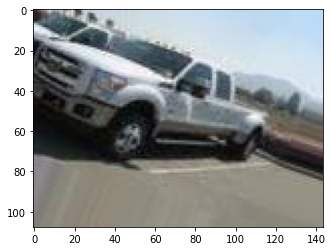

Car :  00005


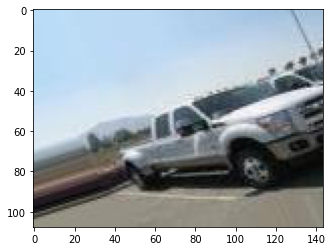

Car :  00005


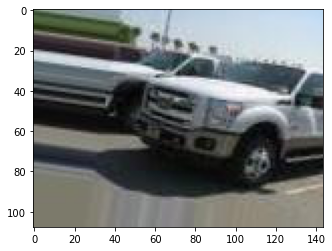

Car :  00005


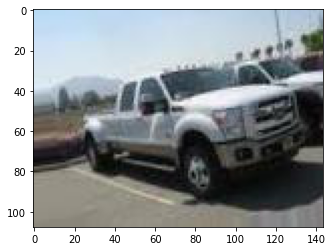

Car :  00005


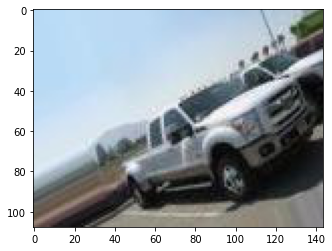

Car :  00005


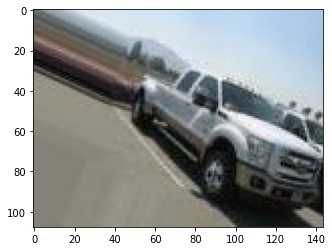

Car :  00005


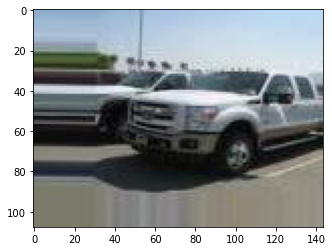

Car :  00005


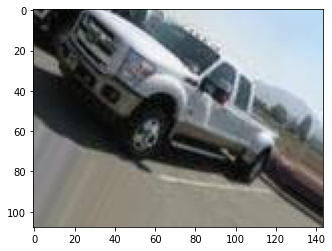

Car :  00005


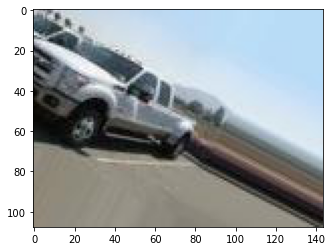

Car :  00005


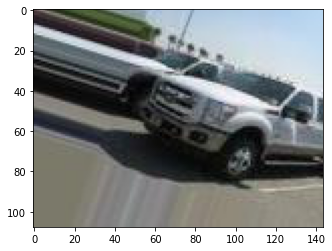

#######################################################################################################################
Car :  00006


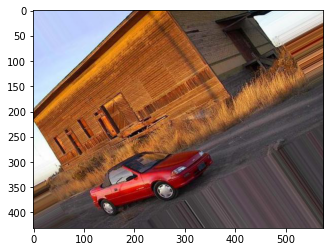

Car :  00006


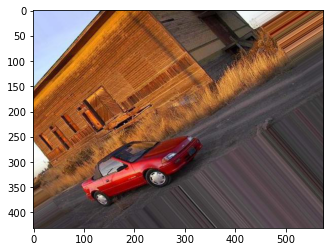

Car :  00006


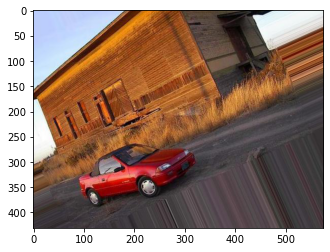

Car :  00006


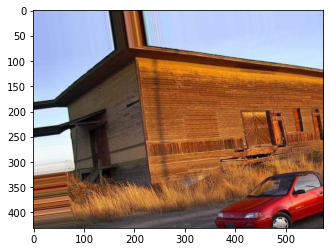

Car :  00006


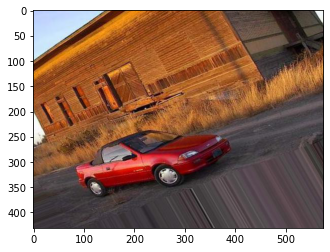

Car :  00006


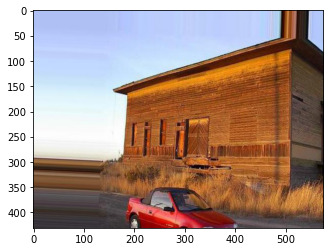

Car :  00006


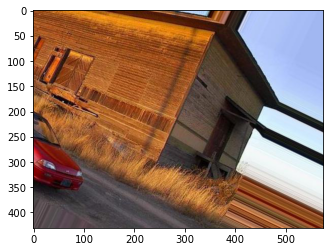

Car :  00006


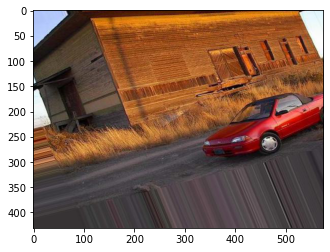

Car :  00006


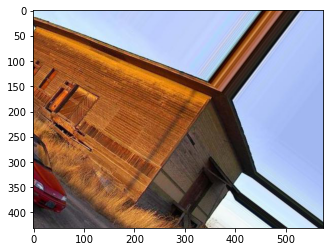

Car :  00006


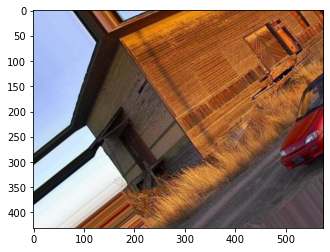

#######################################################################################################################
Car :  00007


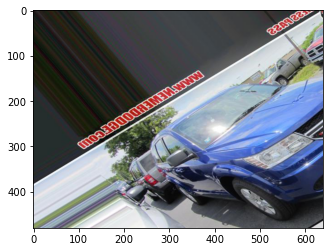

Car :  00007


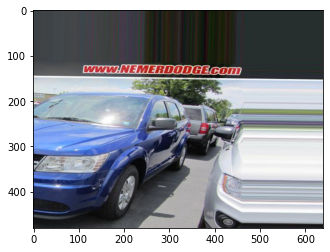

Car :  00007


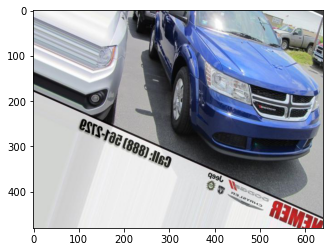

Car :  00007


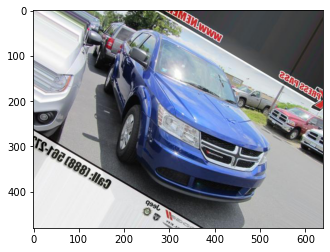

Car :  00007


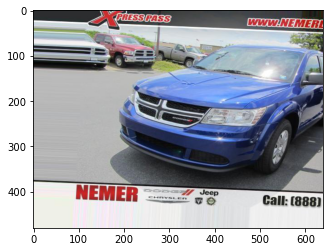

Car :  00007


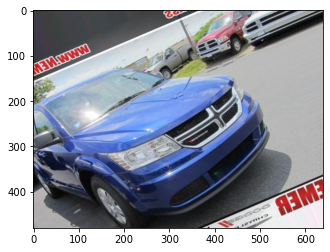

Car :  00007


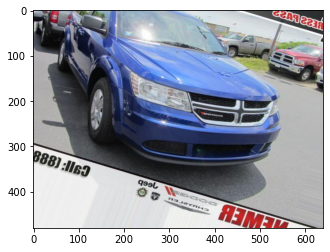

Car :  00007


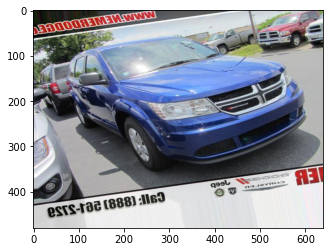

Car :  00007


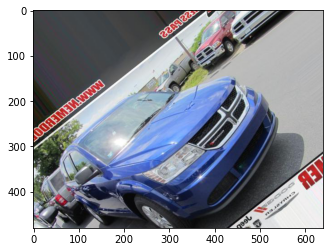

Car :  00007


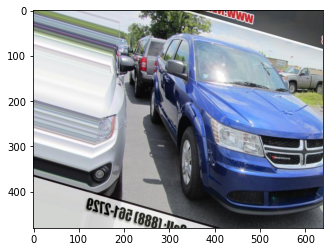

#######################################################################################################################
Car :  00008


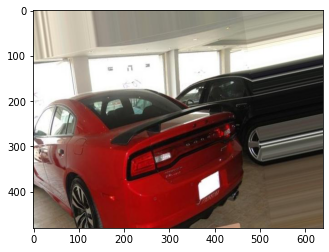

Car :  00008


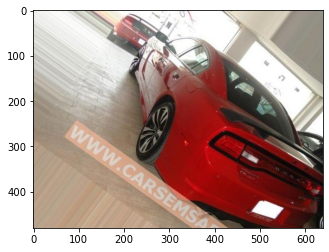

Car :  00008


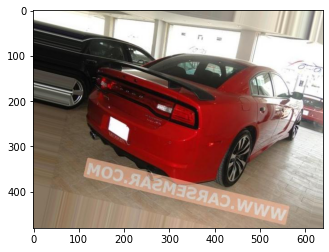

Car :  00008


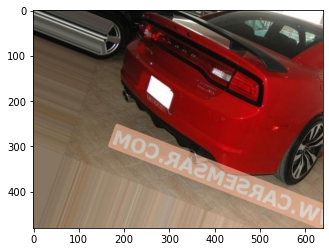

Car :  00008


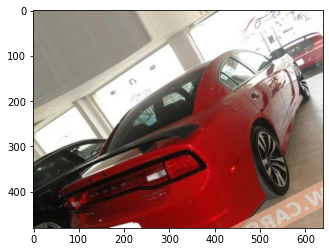

Car :  00008


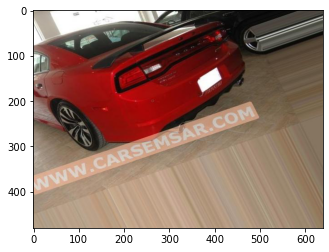

Car :  00008


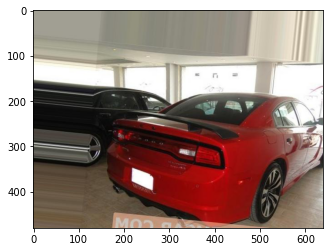

Car :  00008


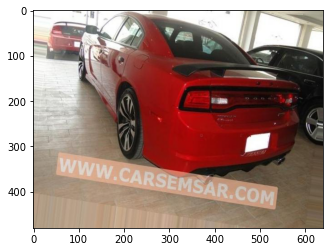

Car :  00008


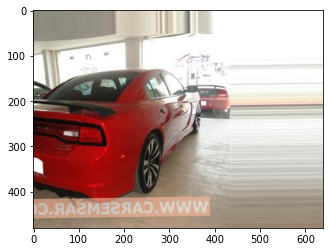

Car :  00008


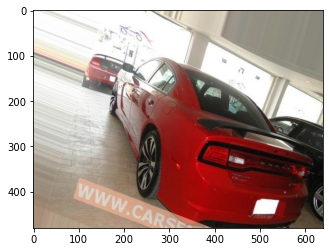

#######################################################################################################################
Car :  00009


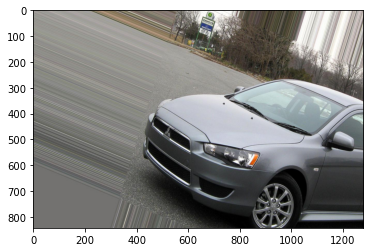

Car :  00009


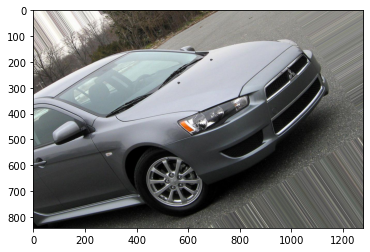

Car :  00009


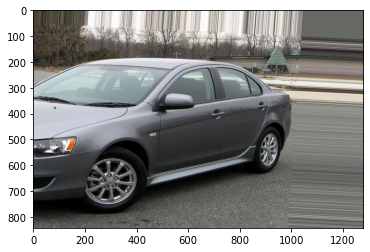

Car :  00009


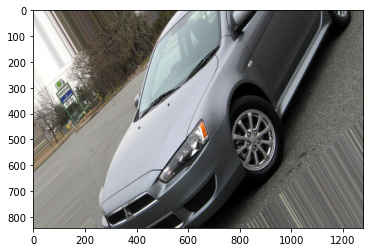

Car :  00009


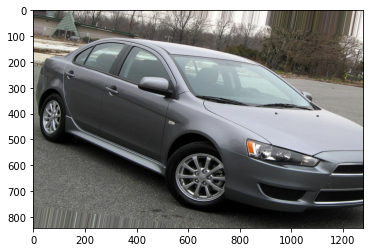

Car :  00009


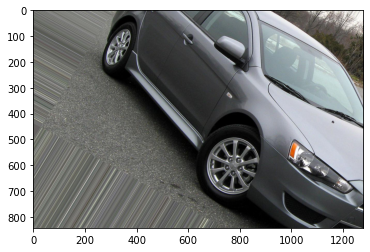

Car :  00009


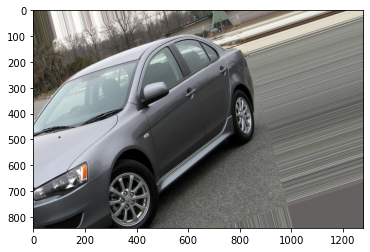

Car :  00009


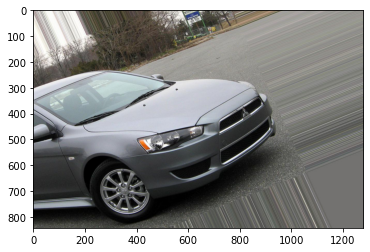

Car :  00009


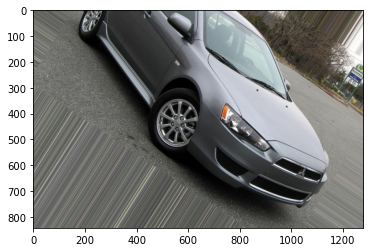

Car :  00009


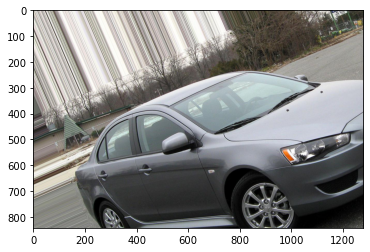

#######################################################################################################################
Car :  00010


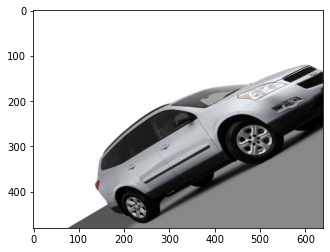

Car :  00010


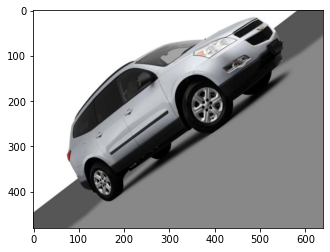

Car :  00010


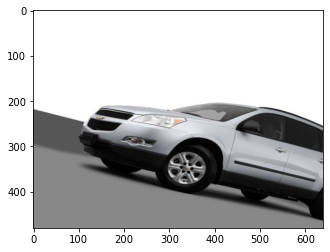

Car :  00010


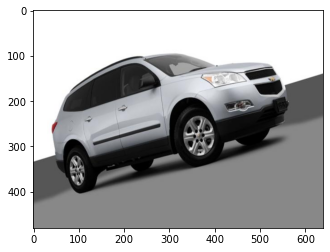

Car :  00010


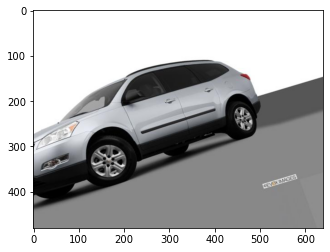

Car :  00010


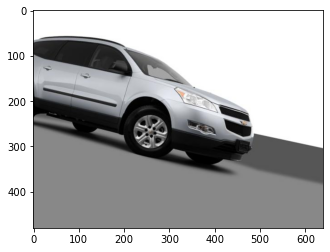

Car :  00010


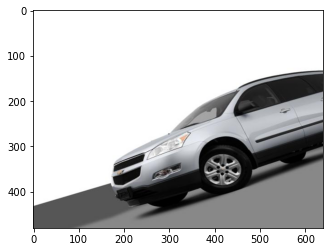

Car :  00010


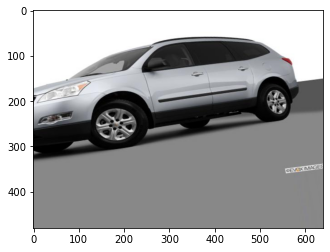

Car :  00010


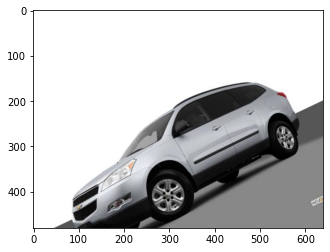

Car :  00010


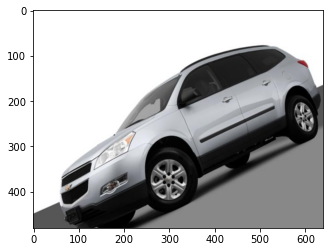

#######################################################################################################################
Car :  00011


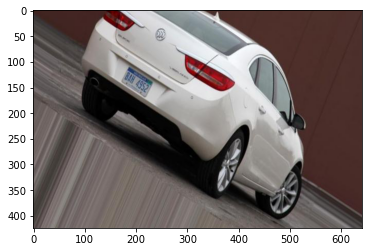

Car :  00011


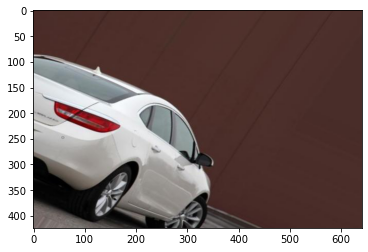

Car :  00011


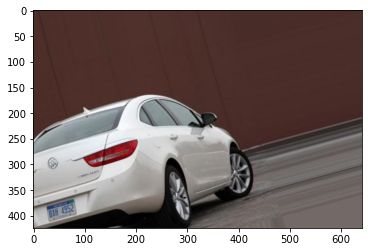

Car :  00011


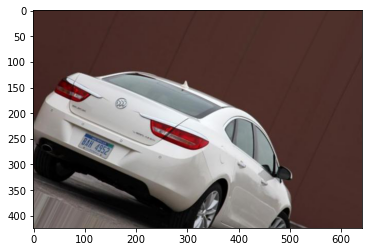

Car :  00011


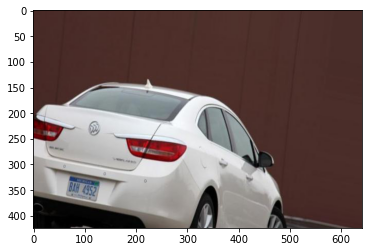

Car :  00011


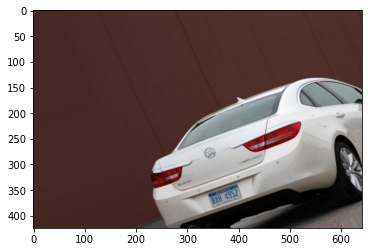

Car :  00011


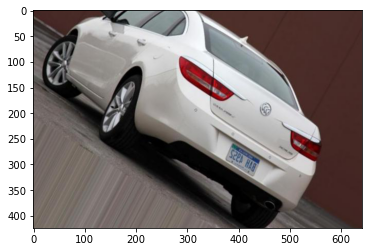

Car :  00011


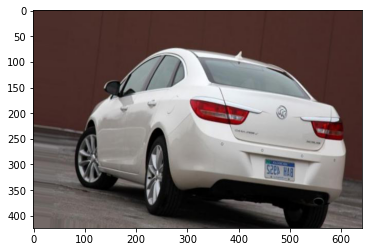

Car :  00011


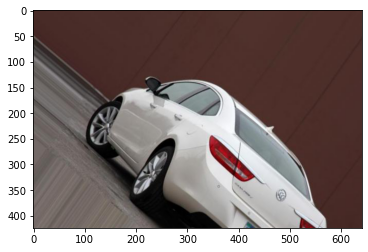

Car :  00011


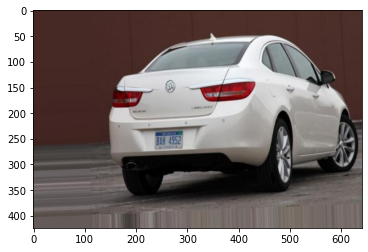

#######################################################################################################################
Car :  00012


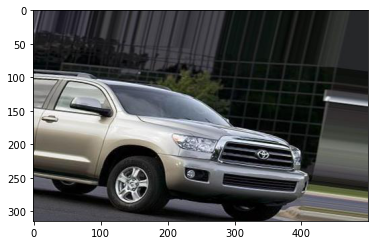

Car :  00012


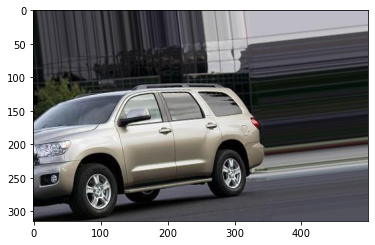

Car :  00012


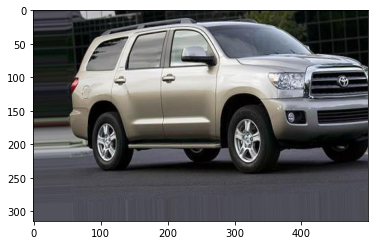

Car :  00012


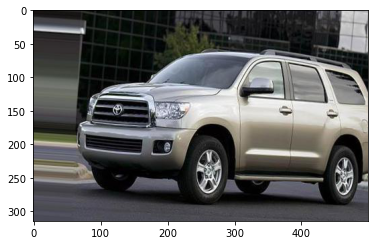

Car :  00012


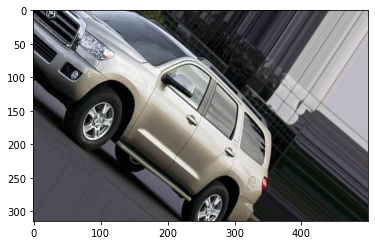

Car :  00012


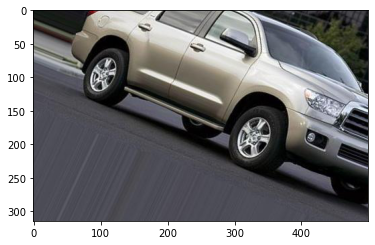

Car :  00012


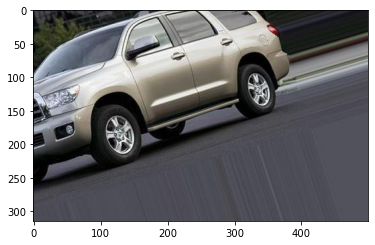

Car :  00012


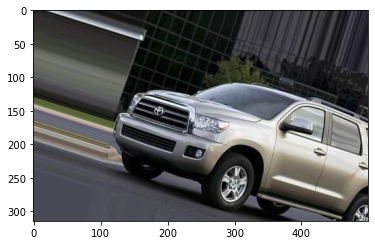

Car :  00012


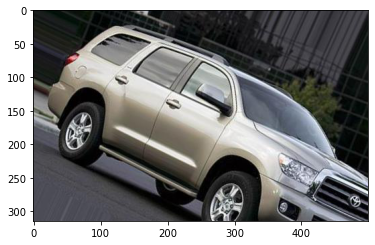

Car :  00012


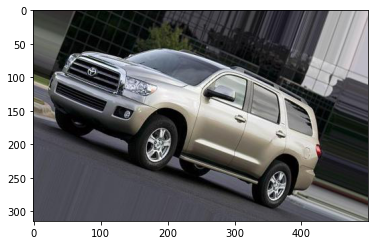

#######################################################################################################################
Car :  00013


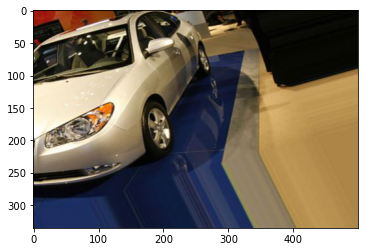

Car :  00013


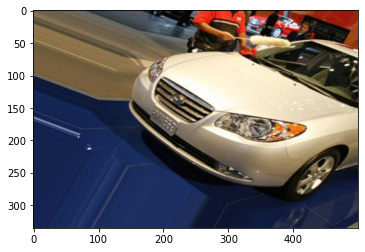

Car :  00013


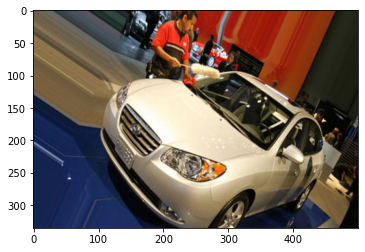

Car :  00013


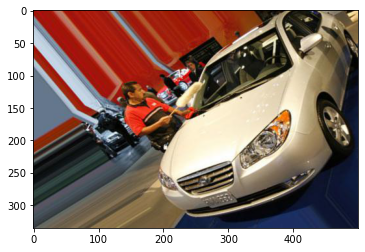

Car :  00013


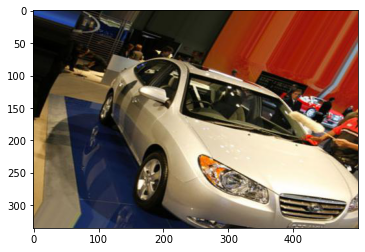

Car :  00013


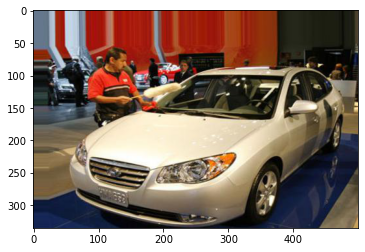

Car :  00013


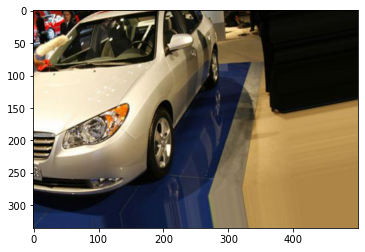

Car :  00013


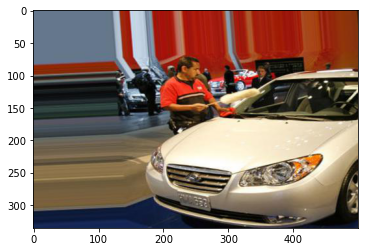

Car :  00013


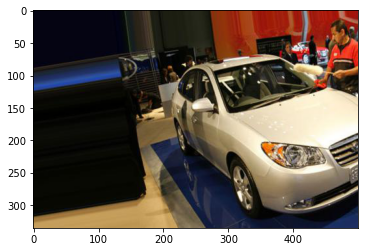

Car :  00013


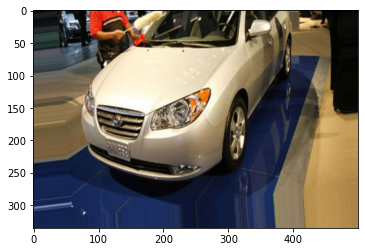

#######################################################################################################################
Car :  00014


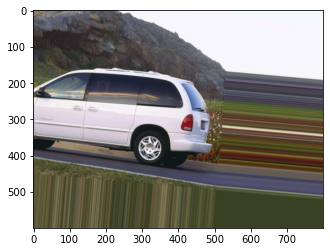

Car :  00014


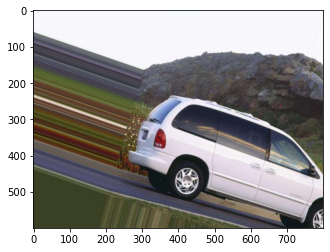

Car :  00014


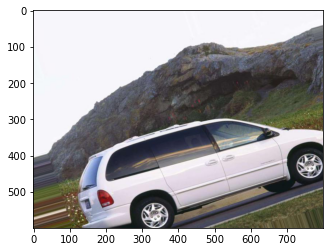

Car :  00014


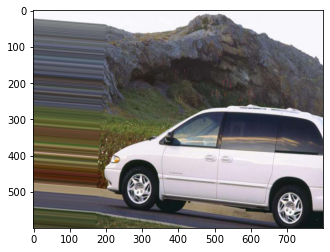

Car :  00014


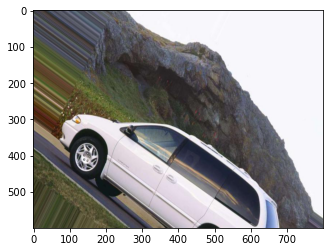

Car :  00014


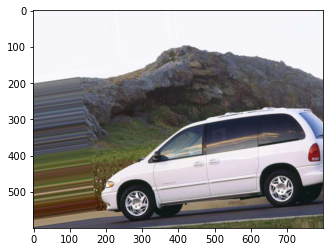

Car :  00014


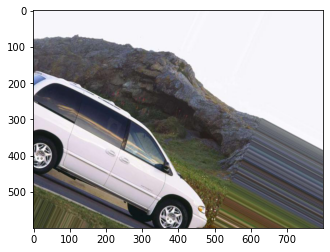

Car :  00014


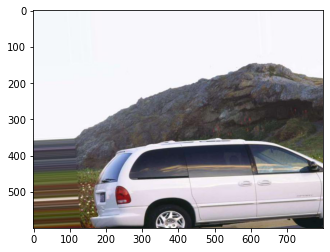

Car :  00014


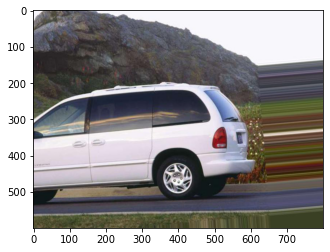

Car :  00014


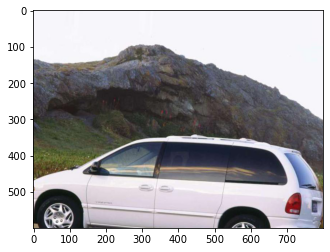

#######################################################################################################################
Car :  00015


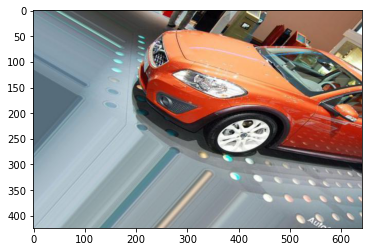

Car :  00015


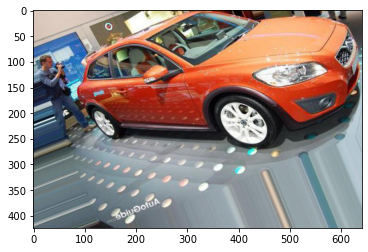

Car :  00015


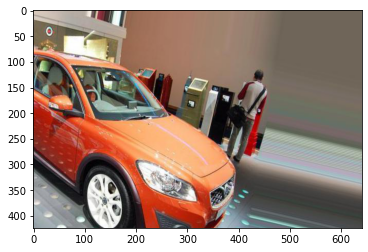

Car :  00015


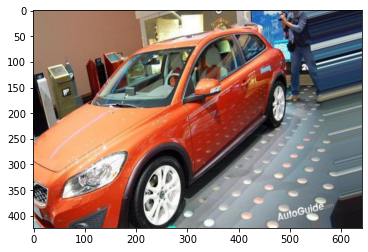

Car :  00015


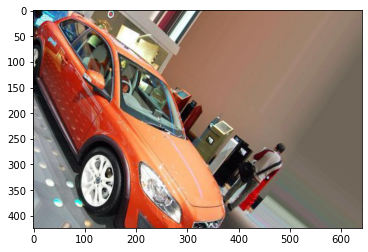

Car :  00015


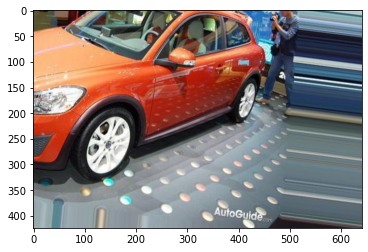

Car :  00015


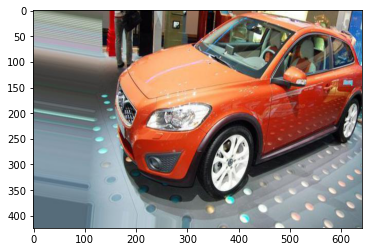

Car :  00015


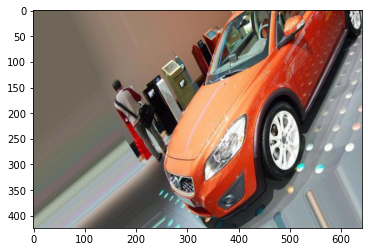

Car :  00015


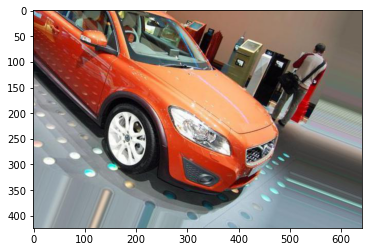

Car :  00015


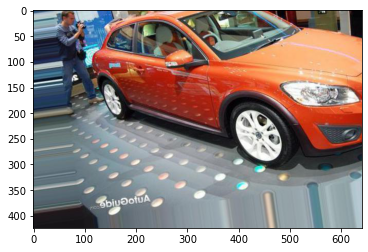

#######################################################################################################################


In [101]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import Image

cars_names = ['00001', '00002', '00003', '00004', '00005', '00006', '00007', '00008', '00009', '00010', '00011', '00012', '00013', '00014', '00015']
for i in cars_names:
        img_dir = 'C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images\\' + i
        images = glob(img_dir + '\\*')
        for image in images:
            print('Car : ',i)
            img = mpimg.imread(image)
            plt.imshow(img)
            plt.show()
        print("#######################################################################################################################")
        

In [100]:
image

'C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\Cars Images\\00004\\0_0_1416.jpeg'

# ------------------------------------------------------------------------------------------------------------

# PART - FOUR

# Flower Classifier

In [36]:
import tflearn.datasets.oxflower17 as oxflower17 

Instructions for updating:
non-resource variables are not supported in the long term


Instructions for updating:
non-resource variables are not supported in the long term


curses is not supported on this machine (please install/reinstall curses for an optimal experience)


In [37]:
X, y = oxflower17.load_data(one_hot=True)

In [38]:
X.shape

(1360, 224, 224, 3)

In [39]:
X = np.asarray(X).reshape(X.shape[0], X.shape[1]*X.shape[2]*X.shape[3])

In [40]:
X.shape

(1360, 150528)

In [41]:
import pickle

pickle_X = open("X_flowers.pickle","wb")
pickle.dump(X,pickle_X)
pickle_X.close()

pickle_Y = open("Y_flowers.pickle","wb")
pickle.dump(y,pickle_Y)
pickle_Y.close()

In [3]:
import pickle
pickle_in = open("X_flowers.pickle","rb")
X = pickle.load(pickle_in)
print('The shape of X is: ',X.shape)

pickle_in = open("Y_flowers.pickle","rb")
y = pickle.load(pickle_in)
print('The shape of y is: ',y.shape)

The shape of X is:  (1360, 150528)
The shape of y is:  (1360, 17)


## Flower Classifier - Using KNN

In [43]:
# Splitting the data into train/test
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,random_state=42)

print('The shape of X_train is: ',X_train.shape)
print('The shape of y_train is: ',y_train.shape)
print('The shape of X_test is: ',X_test.shape)
print('The shape of y_test is: ',y_test.shape)

The shape of X_train is:  (1020, 150528)
The shape of y_train is:  (1020, 17)
The shape of X_test is:  (340, 150528)
The shape of y_test is:  (340, 17)


In [44]:
from sklearn.neighbors import KNeighborsClassifier
import time

StartTime = time.time()

model_knn_flower = KNeighborsClassifier(n_neighbors=3,weights='distance')
model_knn_flower = model_knn_flower.fit(X_train,y_train)
    
y_pred = model_knn_flower.predict(X_test)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

############### Total Time Taken:  3 Minutes #############


In [47]:
# Classification Report
from sklearn import metrics
print(metrics.classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.56      0.25      0.34        20
           1       0.25      0.05      0.08        21
           2       0.94      0.59      0.73        27
           3       1.00      0.17      0.30        23
           4       0.29      0.40      0.33        10
           5       0.21      0.24      0.22        21
           6       0.24      0.33      0.28        15
           7       0.80      0.36      0.50        22
           8       1.00      0.22      0.36        18
           9       0.25      0.08      0.12        13
          10       0.25      0.04      0.06        27
          11       0.00      0.00      0.00        21
          12       0.71      0.62      0.67        16
          13       0.33      0.05      0.09        19
          14       0.00      0.00      0.00        22
          15       0.45      0.35      0.39        26
          16       1.00      0.21      0.35        19

   micro avg       0.45   

In [48]:
accuracy_knn_flower = metrics.classification_report(y_test, y_pred).split()[-2]
accuracy_percentage_knn_flower = float(accuracy_knn_flower)*100

In [49]:
print('The Accuracy of the flower classifier using K-NN model is :',accuracy_percentage_knn_flower,'%')

The Accuracy of the flower classifier using K-NN model is : 23.0 %


## Flower Classifier - Using Deep neural Networks

In [1]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.utils.np_utils import to_categorical
from keras.layers import Activation, Dense
# from keras.layers import BatchNormalization, Dropout
from keras import optimizers

In [17]:
from keras import regularizers
#Initialize the Artificial Neural Network Classifier
flowers_model = Sequential()

flowers_model.add(Dense(128, kernel_initializer = 'he_normal',input_shape = (X.shape[1], )))
#Adding Activation function
flowers_model.add(Activation('relu'))

#Hidden Layer 1
#Adding first Hidden layer of 64 nodes
flowers_model.add(Dense(64, kernel_initializer = 'he_normal'))
#Adding Activation function
flowers_model.add(Activation('relu'))

#Hidden Layer 2
#Adding first Hidden layer of 32 nodes
flowers_model.add(Dense(32, kernel_initializer = 'he_normal'))
#Adding Activation function
flowers_model.add(Activation('relu'))

# Output Layer
#Adding output layer which is of 17 nodes (digits)
flowers_model.add(Dense(17))
#Adding Activation function
# Here, we are using softmax function because we have multiclass classsification
flowers_model.add(Activation('softmax'))

print(flowers_model.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_11 (Dense)             (None, 128)               19267712  
_________________________________________________________________
activation_11 (Activation)   (None, 128)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 64)                8256      
_________________________________________________________________
activation_12 (Activation)   (None, 64)                0         
_________________________________________________________________
dense_13 (Dense)             (None, 32)                2080      
_________________________________________________________________
activation_13 (Activation)   (None, 32)                0         
_________________________________________________________________
dense_14 (Dense)             (None, 17)               

In [18]:
# compiling the ANN classifier
adam = tf.keras.optimizers.Adam(lr=0.0001)
flowers_model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [19]:
import time
# Measuring the time taken by the model to train
StartTime=time.time()
# Fitting the ANN to the Training data
history = flowers_model.fit(X, y,batch_size = 64, epochs = 300, verbose = 1,validation_split=0.25)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/300
16/16 [==============================] - 3s 167ms/step - loss: 29.4154 - accuracy: 0.0598 - val_loss: 19.0167 - val_accuracy: 0.0529
Epoch 2/300
16/16 [==============================] - 2s 138ms/step - loss: 8.4842 - accuracy: 0.0951 - val_loss: 2.9363 - val_accuracy: 0.0647
Epoch 3/300
16/16 [==============================] - 2s 134ms/step - loss: 2.7863 - accuracy: 0.0922 - val_loss: 2.7441 - val_accuracy: 0.0500
Epoch 4/300
16/16 [==============================] - 2s 132ms/step - loss: 2.7691 - accuracy: 0.0618 - val_loss: 2.7714 - val_accuracy: 0.0882
Epoch 5/300
16/16 [==============================] - 2s 133ms/step - loss: 2.7477 - accuracy: 0.0902 - val_loss: 2.8473 - val_accuracy: 0.1206
Epoch 6/300
16/16 [==============================] - 2s 133ms/step - loss: 2.7438 - accuracy: 0.0971 - val_loss: 2.7890 - val_accuracy: 0.0500
Epoch 7/300
16/16 [==============================] - 2s 136ms/step - loss: 2.7399 - accuracy: 0.0922 - val_loss: 2.7470 - val_accuracy: 0.09

Epoch 58/300
16/16 [==============================] - 2s 145ms/step - loss: 1.5055 - accuracy: 0.4549 - val_loss: 2.8511 - val_accuracy: 0.2000
Epoch 59/300
16/16 [==============================] - 2s 144ms/step - loss: 1.6230 - accuracy: 0.4069 - val_loss: 3.4098 - val_accuracy: 0.2382
Epoch 60/300
16/16 [==============================] - 2s 147ms/step - loss: 1.3739 - accuracy: 0.5088 - val_loss: 3.1100 - val_accuracy: 0.2559
Epoch 61/300
16/16 [==============================] - 2s 138ms/step - loss: 1.2955 - accuracy: 0.5167 - val_loss: 2.5337 - val_accuracy: 0.2647
Epoch 62/300
16/16 [==============================] - 2s 135ms/step - loss: 1.1926 - accuracy: 0.5853 - val_loss: 3.0002 - val_accuracy: 0.2676
Epoch 63/300
16/16 [==============================] - 2s 138ms/step - loss: 1.1733 - accuracy: 0.5745 - val_loss: 3.0586 - val_accuracy: 0.2265
Epoch 64/300
16/16 [==============================] - 2s 139ms/step - loss: 1.1920 - accuracy: 0.5559 - val_loss: 3.1372 - val_accuracy:

Epoch 115/300
16/16 [==============================] - 2s 138ms/step - loss: 0.2385 - accuracy: 0.9265 - val_loss: 4.7895 - val_accuracy: 0.3176
Epoch 116/300
16/16 [==============================] - 2s 138ms/step - loss: 0.1742 - accuracy: 0.9451 - val_loss: 4.5086 - val_accuracy: 0.3529
Epoch 117/300
16/16 [==============================] - 2s 136ms/step - loss: 0.1830 - accuracy: 0.9402 - val_loss: 4.3916 - val_accuracy: 0.3382
Epoch 118/300
16/16 [==============================] - 2s 132ms/step - loss: 0.1382 - accuracy: 0.9657 - val_loss: 4.1489 - val_accuracy: 0.3441
Epoch 119/300
16/16 [==============================] - 2s 135ms/step - loss: 0.1176 - accuracy: 0.9676 - val_loss: 4.7097 - val_accuracy: 0.3294
Epoch 120/300
16/16 [==============================] - 4s 221ms/step - loss: 0.0920 - accuracy: 0.9755 - val_loss: 4.3878 - val_accuracy: 0.3471
Epoch 121/300
16/16 [==============================] - 3s 205ms/step - loss: 0.0774 - accuracy: 0.9824 - val_loss: 4.4032 - val_ac

16/16 [==============================] - 3s 201ms/step - loss: 0.0066 - accuracy: 1.0000 - val_loss: 5.4365 - val_accuracy: 0.3618
Epoch 172/300
16/16 [==============================] - 3s 202ms/step - loss: 0.0067 - accuracy: 1.0000 - val_loss: 5.4686 - val_accuracy: 0.3735
Epoch 173/300
16/16 [==============================] - 3s 200ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 5.5026 - val_accuracy: 0.3618
Epoch 174/300
16/16 [==============================] - 3s 203ms/step - loss: 0.0062 - accuracy: 1.0000 - val_loss: 5.4729 - val_accuracy: 0.3618
Epoch 175/300
16/16 [==============================] - 3s 201ms/step - loss: 0.0065 - accuracy: 1.0000 - val_loss: 5.5618 - val_accuracy: 0.3559
Epoch 176/300
16/16 [==============================] - 3s 203ms/step - loss: 0.0061 - accuracy: 1.0000 - val_loss: 5.5513 - val_accuracy: 0.3559
Epoch 177/300
16/16 [==============================] - 3s 202ms/step - loss: 0.0058 - accuracy: 1.0000 - val_loss: 5.4538 - val_accuracy: 0.3647

16/16 [==============================] - 3s 204ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 6.2598 - val_accuracy: 0.3647
Epoch 228/300
16/16 [==============================] - 3s 205ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 6.2418 - val_accuracy: 0.3618
Epoch 229/300
16/16 [==============================] - 3s 203ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 6.2587 - val_accuracy: 0.3647
Epoch 230/300
16/16 [==============================] - 3s 188ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 6.2825 - val_accuracy: 0.3618
Epoch 231/300
16/16 [==============================] - 3s 193ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 6.3120 - val_accuracy: 0.3647
Epoch 232/300
16/16 [==============================] - 3s 192ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 6.3184 - val_accuracy: 0.3618
Epoch 233/300
16/16 [==============================] - 3s 191ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 6.2914 - val_accuracy: 0.3676

Epoch 283/300
16/16 [==============================] - 3s 200ms/step - loss: 6.2702e-04 - accuracy: 1.0000 - val_loss: 6.8823 - val_accuracy: 0.3765
Epoch 284/300
16/16 [==============================] - 3s 201ms/step - loss: 6.2100e-04 - accuracy: 1.0000 - val_loss: 6.9147 - val_accuracy: 0.3735
Epoch 285/300
16/16 [==============================] - 3s 199ms/step - loss: 6.0546e-04 - accuracy: 1.0000 - val_loss: 6.9506 - val_accuracy: 0.3706
Epoch 286/300
16/16 [==============================] - 3s 203ms/step - loss: 5.8950e-04 - accuracy: 1.0000 - val_loss: 6.9532 - val_accuracy: 0.3647
Epoch 287/300
16/16 [==============================] - 3s 201ms/step - loss: 5.9201e-04 - accuracy: 1.0000 - val_loss: 6.9619 - val_accuracy: 0.3765
Epoch 288/300
16/16 [==============================] - 3s 201ms/step - loss: 5.6901e-04 - accuracy: 1.0000 - val_loss: 6.9596 - val_accuracy: 0.3794
Epoch 289/300
16/16 [==============================] - 3s 204ms/step - loss: 5.6160e-04 - accuracy: 1.0000

In [20]:
print('Validation accuracy using ANN for flower classifier is : ', max(history.history['val_accuracy'])*100,'%')

Validation accuracy using ANN for flower classifier is :  38.235294818878174 %


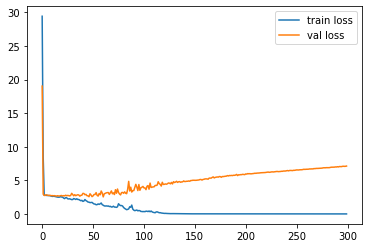

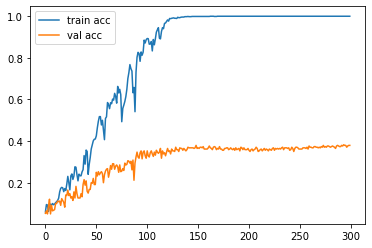

In [23]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [25]:
# save it as a pickle file
from tensorflow.keras.models import load_model
flowers_model.save('flower_model_ann.pkl')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: flower_model_ann.pkl\assets


## Flower Classifier - Using Convolutional Neural Networks

In [26]:
# Deep Learning CNN model to recognize the flower

'''########################## IMAGE PRE-PROCESSING for TRAINING and TESTING data ##############################'''

TrainingImagePath='C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\flowers'

from keras.preprocessing.image import ImageDataGenerator

# Defining pre-processing transformations on raw images of training data
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        validation_split=0.25)

# Generating the Training Data
training_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='training')


# Generating the Validation Data
validation_set = train_datagen.flow_from_directory(
        TrainingImagePath,
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        subset='validation')

# Printing class labels for each face
# test_set.class_indices

Found 1020 images belonging to 17 classes.
Found 340 images belonging to 17 classes.


In [27]:
'''#################### Creating lookup table for all flowers ##############################'''

# class_indices have the numeric tag for each flower
TrainClasses=training_set.class_indices

# Storing the flower and the numeric tag for future reference
ResultMap={}
for flowerValue,flowerName in zip(TrainClasses.values(),TrainClasses.keys()):
    ResultMap[flowerValue]=flowerName

# Saving the flower map for future reference
import pickle
with open("C:\\Users\\admin\\Desktop\\Great Learning\\Computer Vision\\Project\\ResultsMap_flowers.pkl", 'wb') as f:
    pickle.dump(ResultMap, f, pickle.HIGHEST_PROTOCOL)

print("Mapping of Flower Type and its ID",ResultMap)

# The number of neurons for the output layer is equal to the number of flowers
OutputNeurons=len(ResultMap)
print('\n The Number of output neurons: ', OutputNeurons)

Mapping of Flower Type and its ID {0: '0', 1: '1', 2: '10', 3: '11', 4: '12', 5: '13', 6: '14', 7: '15', 8: '16', 9: '2', 10: '3', 11: '4', 12: '5', 13: '6', 14: '7', 15: '8', 16: '9'}

 The Number of output neurons:  17


In [28]:
'''######################## Creating CNN deep learning model ####################################'''

from keras.models import Sequential
from keras.layers import Convolution2D
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense

'''Initializing the Convolutional Neural Network'''
flower_classifier= Sequential()

''' STEP--1 Convolution
# Adding the first layer of CNN
# we are using the format (224,224,3) because we are using TensorFlow backend
# It means 3 matrix of size (224X224) pixels representing Red, Green and Blue components of pixels
'''
flower_classifier.add(Convolution2D(32, kernel_size=(5, 5), strides=(1, 1), input_shape=(224,224,3), activation='relu'))

'''# STEP--2 MAX Pooling'''
flower_classifier.add(MaxPool2D(pool_size=(2,2)))

'''############## ADDITIONAL LAYER of CONVOLUTION for better accuracy #################'''
flower_classifier.add(Convolution2D(64, kernel_size=(5, 5), strides=(1, 1), activation='relu'))

flower_classifier.add(MaxPool2D(pool_size=(2,2)))


'''# STEP--3 FLattening'''
flower_classifier.add(Flatten())

'''# STEP--4 Fully Connected Neural Network'''
flower_classifier.add(Dense(512, activation='relu'))

flower_classifier.add(Dense(OutputNeurons, activation='softmax'))

'''# Compiling the CNN'''
#flower_classifier.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
flower_classifier.compile(loss='categorical_crossentropy', optimizer = 'adam', metrics=["accuracy"])

In [29]:
import time
# Measuring the time taken by the model to train
StartTime=time.time()

# Starting the model training
history = flower_classifier.fit_generator(
                    training_set,
                    steps_per_epoch=30,validation_data=validation_set,
                    epochs=25)

EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/25
30/30 [==============================] - 169s 6s/step - loss: 4.5592 - accuracy: 0.1538 - val_loss: 1.9159 - val_accuracy: 0.3500
Epoch 2/25
30/30 [==============================] - 157s 5s/step - loss: 1.9003 - accuracy: 0.3672 - val_loss: 1.5436 - val_accuracy: 0.4294
Epoch 3/25
30/30 [==============================] - 156s 5s/step - loss: 1.5928 - accuracy: 0.4749 - val_loss: 1.6651 - val_accuracy: 0.4294
Epoch 4/25
30/30 [==============================] - 164s 5s/step - loss: 1.3457 - accuracy: 0.5439 - val_loss: 1.3156 - val_accuracy: 0.5265
Epoch 5/25
30/30 [==============================] - 157s 5s/step - loss: 1.1063 - accuracy: 0.6339 - val_loss: 1.5771 - val_accuracy: 0.5294
Epoch 6/25
30/30 [==============================] - 157s 5s/step - loss: 1.0563 - accuracy: 0.6548 - val_loss: 1.5540 - val_accuracy: 0.5353
Epoch 7/25
30/30 [==============================] - 157s 5s/step - loss: 0.867

In [30]:
results = flower_classifier.evaluate(validation_set)
print('Validation accuracy for flower classifier using CNN is : ', results[1]*100,'%')

11/11 [==============================] - 17s 2s/step - loss: 2.4046 - accuracy: 0.5941
Validation accuracy for flower classifier using CNN is :  59.41176414489746 %


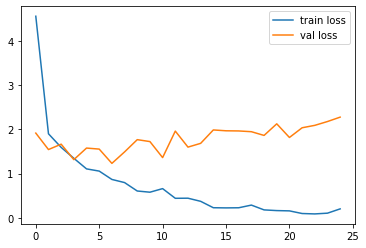

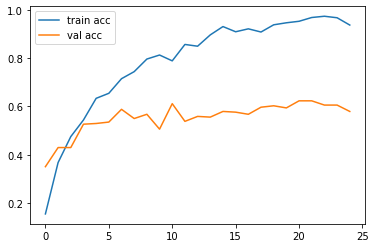

In [31]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [32]:
# save it as a pickle file
from tensorflow.keras.models import load_model
flower_classifier.save('flower_classifier_cnn.pkl')

INFO:tensorflow:Assets written to: flower_classifier_cnn.pkl\assets


In [33]:
'''########################## Making single predictions ############################'''
import numpy as np
from keras.preprocessing import image

testImage='C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/predict-flower.jpg'
test_image=image.load_img(testImage,target_size=(224, 224))
test_image=image.img_to_array(test_image)

test_image=np.expand_dims(test_image,axis=0)

result=flower_classifier.predict(test_image,verbose=0)
#print(training_set.class_indices)

print('####'*10)
print('Prediction is: ',ResultMap[np.argmax(result)])

########################################
Prediction is:  15


## Flower Classifier - Using Transfer Learning Techniques

In [34]:
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import warnings
warnings.filterwarnings("ignore")

## Transfer Learning Using Inception V3

In [35]:
# re-size all the images to this
IMAGE_SIZE = [224, 224]

train_path = 'C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/flowers'

In [36]:
inception = InceptionV3(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

# don't train existing weights
for layer in inception.layers:
    layer.trainable = False
# useful for getting number of output classes
folders = glob('C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/flowers/*')
x = Flatten()(inception.output)

In [37]:
prediction = Dense(len(folders), activation='softmax')(x)

# create a model object
inception_model = Model(inputs=inception.input, outputs=prediction)

# view the structure of the model
inception_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 111, 111, 32) 96          conv2d_2[0][0]                   
__________________________________________________________________________________________________
activation_15 (Activation)      (None, 111, 111, 32) 0           batch_normalization[0][0]        
_______________________________________________________________________________________

__________________________________________________________________________________________________
conv2d_84 (Conv2D)              (None, 5, 5, 384)    442368      activation_96[0][0]              
__________________________________________________________________________________________________
conv2d_85 (Conv2D)              (None, 5, 5, 384)    442368      activation_96[0][0]              
__________________________________________________________________________________________________
average_pooling2d_7 (AveragePoo (None, 5, 5, 1280)   0           mixed8[0][0]                     
__________________________________________________________________________________________________
conv2d_78 (Conv2D)              (None, 5, 5, 320)    409600      mixed8[0][0]                     
__________________________________________________________________________________________________
batch_normalization_78 (BatchNo (None, 5, 5, 384)    1152        conv2d_80[0][0]                  
__________

In [38]:
inception_model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [39]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True,
                                  validation_split=0.25)

In [40]:
training_set = train_datagen.flow_from_directory('C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/flowers',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical',
                                                subset='training')

validation_set = train_datagen.flow_from_directory('C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/flowers',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical',
                                                subset='validation')

Found 1020 images belonging to 17 classes.
Found 340 images belonging to 17 classes.


In [41]:
import time

StartTime = time.time()
r = inception_model.fit_generator(
  training_set,
  epochs=10,
  validation_data = validation_set,
  steps_per_epoch=len(training_set)
)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/10
32/32 [==============================] - 150s 5s/step - loss: 8.2600 - accuracy: 0.4892 - val_loss: 1.8241 - val_accuracy: 0.7853
Epoch 2/10
32/32 [==============================] - 146s 5s/step - loss: 1.3433 - accuracy: 0.8225 - val_loss: 1.1688 - val_accuracy: 0.8618
Epoch 3/10
32/32 [==============================] - 151s 5s/step - loss: 0.7986 - accuracy: 0.8824 - val_loss: 1.4232 - val_accuracy: 0.8206
Epoch 4/10
32/32 [==============================] - 95s 3s/step - loss: 0.6119 - accuracy: 0.9098 - val_loss: 0.9743 - val_accuracy: 0.8647
Epoch 5/10
32/32 [==============================] - 81s 3s/step - loss: 0.3749 - accuracy: 0.9412 - val_loss: 1.7279 - val_accuracy: 0.8294
Epoch 6/10
32/32 [==============================] - 82s 3s/step - loss: 0.2301 - accuracy: 0.9578 - val_loss: 0.7774 - val_accuracy: 0.8824
Epoch 7/10
32/32 [==============================] - 81s 3s/step - loss: 0.2698 - accuracy: 0.9451 - val_loss: 2.0720 - val_accuracy: 0.7971
Epoch 8/10
32/32 

In [42]:
results = inception_model.evaluate(validation_set)
print('Validation accuracy using Inception_V3 is : ', results[1]*100,'%')

11/11 [==============================] - 19s 2s/step - loss: 1.2743 - accuracy: 0.8765
Validation accuracy using Inception_V3 is :  87.64705657958984 %


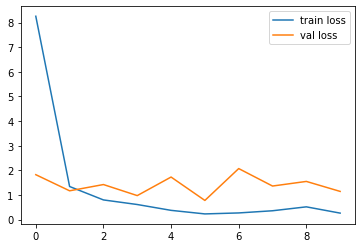

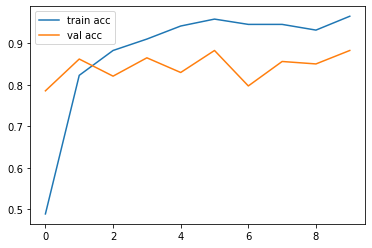

<Figure size 432x288 with 0 Axes>

In [43]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

# plot the accuracy
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [44]:
# save it as a pickle file
from tensorflow.keras.models import load_model
inception_model.save('inception_v3_model.pkl')

INFO:tensorflow:Assets written to: inception_v3_model.pkl\assets


## Transfer Learning Using Resnet50 

In [45]:
# Here we will be using imagenet weights
resnet = ResNet50(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

In [46]:
x = Flatten()(resnet.output)
prediction = Dense(len(folders), activation='softmax')(x)
# don't train existing weights
for layer in resnet.layers:
    layer.trainable = False
# create a model object
resnet50_model = Model(inputs=resnet.input, outputs=prediction)

resnet50_model.summary()

Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
_______________________________________________________________________________________

In [47]:
resnet50_model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [48]:
import time

StartTime = time.time()
r = resnet50_model.fit_generator(
  training_set,
  epochs=15,
  validation_data = validation_set,
  steps_per_epoch=len(training_set)
)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/15
32/32 [==============================] - 116s 4s/step - loss: 13.9966 - accuracy: 0.0745 - val_loss: 7.8679 - val_accuracy: 0.0824
Epoch 2/15
32/32 [==============================] - 115s 4s/step - loss: 4.1504 - accuracy: 0.1745 - val_loss: 2.6533 - val_accuracy: 0.2147
Epoch 3/15
32/32 [==============================] - 115s 4s/step - loss: 2.8550 - accuracy: 0.2686 - val_loss: 3.1326 - val_accuracy: 0.2353
Epoch 4/15
32/32 [==============================] - 121s 4s/step - loss: 2.3630 - accuracy: 0.3216 - val_loss: 2.4882 - val_accuracy: 0.3324
Epoch 5/15
32/32 [==============================] - 157s 5s/step - loss: 2.2918 - accuracy: 0.3382 - val_loss: 3.1325 - val_accuracy: 0.2471
Epoch 6/15
32/32 [==============================] - 201s 6s/step - loss: 2.3474 - accuracy: 0.3451 - val_loss: 3.0377 - val_accuracy: 0.2265
Epoch 7/15
32/32 [==============================] - 206s 6s/step - loss: 2.4398 - accuracy: 0.3686 - val_loss: 2.4246 - val_accuracy: 0.4000
Epoch 8/15
3

In [49]:
results = resnet50_model.evaluate(validation_set)
print('Validation accuracy using ResNet50 is : ', results[1]*100,'%')

11/11 [==============================] - 47s 4s/step - loss: 2.7124 - accuracy: 0.3676
Validation accuracy using ResNet50 is :  36.764705181121826 %


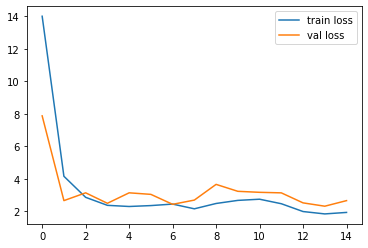

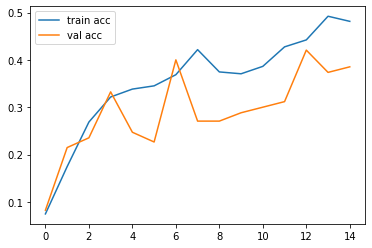

<Figure size 432x288 with 0 Axes>

In [50]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

# plot the accuracy
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [51]:
# save it as a pickle file
from tensorflow.keras.models import load_model
inception_model.save('resnet50_model.pkl')

INFO:tensorflow:Assets written to: resnet50_model.pkl\assets


## Transfer Learning Using Resnet152V2

In [52]:
# Here we will be using imagenet weights
resnet152V2 = ResNet152V2(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

234553344/234545216 [==============================] - 29s 0us/step


In [53]:
x = Flatten()(resnet152V2.output)
prediction = Dense(len(folders), activation='softmax')(x)
# don't train existing weights
for layer in resnet152V2.layers:
    layer.trainable = False
# create a model object
resnet152V2_model = Model(inputs=resnet152V2.input, outputs=prediction)

resnet152V2_model.summary()

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_3[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 114, 114, 64) 0           conv1_conv[0][0]                 
_______________________________________________________________________________________

conv4_block16_2_bn (BatchNormal (None, 14, 14, 256)  1024        conv4_block16_2_conv[0][0]       
__________________________________________________________________________________________________
conv4_block16_2_relu (Activatio (None, 14, 14, 256)  0           conv4_block16_2_bn[0][0]         
__________________________________________________________________________________________________
conv4_block16_3_conv (Conv2D)   (None, 14, 14, 1024) 263168      conv4_block16_2_relu[0][0]       
__________________________________________________________________________________________________
conv4_block16_out (Add)         (None, 14, 14, 1024) 0           conv4_block15_out[0][0]          
                                                                 conv4_block16_3_conv[0][0]       
__________________________________________________________________________________________________
conv4_block17_preact_bn (BatchN (None, 14, 14, 1024) 4096        conv4_block16_out[0][0]          
__________

In [54]:
resnet152V2_model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [55]:
import time

StartTime = time.time()
r = resnet152V2_model.fit_generator(
  training_set,
  epochs=15,
  validation_data = validation_set,
  steps_per_epoch=len(training_set)
)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/15
32/32 [==============================] - 545s 17s/step - loss: 2.8983 - accuracy: 0.6706 - val_loss: 2.1266 - val_accuracy: 0.8206
Epoch 2/15
32/32 [==============================] - 544s 17s/step - loss: 0.8583 - accuracy: 0.9039 - val_loss: 2.8788 - val_accuracy: 0.8206
Epoch 3/15
32/32 [==============================] - 539s 17s/step - loss: 0.5931 - accuracy: 0.9382 - val_loss: 2.5142 - val_accuracy: 0.8206
Epoch 4/15
32/32 [==============================] - 537s 17s/step - loss: 0.4884 - accuracy: 0.9500 - val_loss: 3.2305 - val_accuracy: 0.8265
Epoch 5/15
32/32 [==============================] - 375s 12s/step - loss: 0.4112 - accuracy: 0.9480 - val_loss: 2.1291 - val_accuracy: 0.8441
Epoch 6/15
32/32 [==============================] - 310s 10s/step - loss: 0.3790 - accuracy: 0.9618 - val_loss: 1.8628 - val_accuracy: 0.8765
Epoch 7/15
32/32 [==============================] - 311s 10s/step - loss: 0.2730 - accuracy: 0.9696 - val_loss: 2.1724 - val_accuracy: 0.8882
Epoch 

In [56]:
results = resnet152V2_model.evaluate(validation_set)
print('Validation accuracy using ResNet152V2 is : ', results[1]*100,'%')

11/11 [==============================] - 73s 7s/step - loss: 3.7132 - accuracy: 0.8618
Validation accuracy using ResNet152V2 is :  86.17647290229797 %


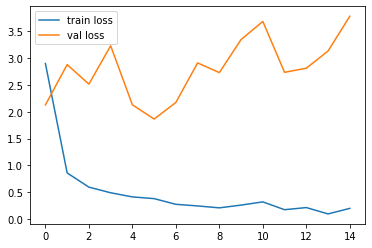

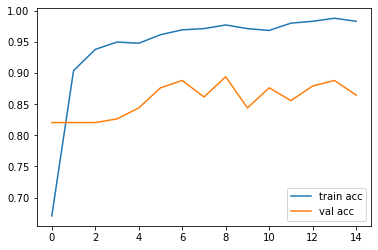

In [57]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [58]:
# save it as a pickle file
from tensorflow.keras.models import load_model
inception_model.save('resnet152V2_model.pkl')

INFO:tensorflow:Assets written to: resnet152V2_model.pkl\assets


## Transfer Learning Using VGG16

In [59]:
# Here we will be using imagenet weights
VGG16 = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

58892288/58889256 [==============================] - 13s 0us/step


In [60]:
x = Flatten()(VGG16.output)
prediction = Dense(len(folders), activation='softmax')(x)
# don't train existing weights
for layer in VGG16.layers:
    layer.trainable = False
# create a model object
VGG16_model = Model(inputs=VGG16.input, outputs=prediction)

VGG16_model.summary()

Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [61]:
VGG16_model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [62]:
import time

StartTime = time.time()
r = VGG16_model.fit_generator(
  training_set,
  epochs=15,
  validation_data = validation_set,
  steps_per_epoch=len(training_set)
)
EndTime=time.time()
print("############### Total Time Taken: ", round((EndTime-StartTime)/60), 'Minutes #############')

Epoch 1/15
32/32 [==============================] - 354s 11s/step - loss: 2.0029 - accuracy: 0.4324 - val_loss: 0.9262 - val_accuracy: 0.7029
Epoch 2/15
32/32 [==============================] - 353s 11s/step - loss: 0.5526 - accuracy: 0.8294 - val_loss: 0.5635 - val_accuracy: 0.8294
Epoch 3/15
32/32 [==============================] - 359s 11s/step - loss: 0.3343 - accuracy: 0.9078 - val_loss: 0.6929 - val_accuracy: 0.7647
Epoch 4/15
32/32 [==============================] - 354s 11s/step - loss: 0.2292 - accuracy: 0.9402 - val_loss: 0.5956 - val_accuracy: 0.8294
Epoch 5/15
32/32 [==============================] - 353s 11s/step - loss: 0.1393 - accuracy: 0.9647 - val_loss: 0.7291 - val_accuracy: 0.8059
Epoch 6/15
32/32 [==============================] - 356s 11s/step - loss: 0.1270 - accuracy: 0.9686 - val_loss: 0.5377 - val_accuracy: 0.8559
Epoch 7/15
32/32 [==============================] - 354s 11s/step - loss: 0.0678 - accuracy: 0.9902 - val_loss: 0.5681 - val_accuracy: 0.8324
Epoch 

In [63]:
results = VGG16_model.evaluate(validation_set)
print('Validation accuracy using VGG16 is : ', results[1]*100,'%')

11/11 [==============================] - 81s 7s/step - loss: 0.4611 - accuracy: 0.8618
Validation accuracy using VGG16 is :  86.17647290229797 %


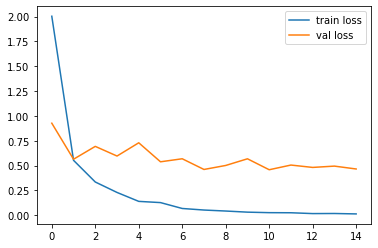

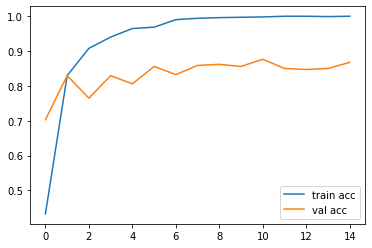

In [64]:
import matplotlib.pyplot as plt
# plot the loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()

# plot the accuracy
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()

In [65]:
# save it as a pickle file
from tensorflow.keras.models import load_model
inception_model.save('VGG16_model.pkl')

INFO:tensorflow:Assets written to: VGG16_model.pkl\assets


## We can clearly see that transfer learning models perform better than the CNN,DL and ML models. VGG16 has been chosen here are the best performing model.

## GUI Implementation For The Best Performing Model

## Flower To Be Predicted
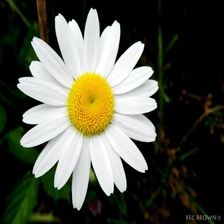

In [68]:
import tkinter as tk
from tkinter import ttk
import pandas as pd
from keras.preprocessing import image

def import_file():
    global test_image
    file_name = file.get()
    print(file_name,' has been successfully Imported!')
    if '.jpg' in file_name:
        test_image = 'C:/Users/admin/Desktop/Great Learning/Computer Vision/Project/' + file_name
#         print(test_image)
        test_image = image.load_img(test_image,target_size=(224,224))
        test_image = image.img_to_array(test_image)
        print('The shape of the test image is: ',test_image.shape)
        test_image = np.expand_dims(test_image,axis=0)
#         print('Image has been imported!')
    var = 'Imported !'
    box = tk.Entry(win,width=10,textvariable=var)
    box.grid(row=0,column=5)
    box.insert(1,var)
    return test_image

def predict_class():
    result = VGG16_model.predict(test_image,verbose=0)
    print('The image belongs to class: ',np.argmax(result))
    box2 = tk.Entry(win,width=10,textvariable=np.argmax(result))
    box2.grid(row=1,column=3)
    var1 = 'Class : ' + str(np.argmax(result))
    box2.insert(1,var1)
       
win = tk.Tk()
win.title('Classifier GUI - Great Learning')

name = tk.Label(win,text='Step 1: Image File     ')
name.grid(row=0,column=0,sticky=tk.W)

file = tk.StringVar()
box = tk.Entry(win,width=40,textvariable=file)
box.grid(row=0,column=1)

space = tk.Label(win,text='     ')
space.grid(row=0,column=2,sticky=tk.W)

button1 = tk.Button(win,text='Import the image file',command=import_file)
button1.grid(row=0,column=3,pady = 10, padx = 10)

space = tk.Label(win,text='     ')
space.grid(row=0,column=4,sticky=tk.W)

# ------------------------------------------------- FLOWER CLASSIFIER PREDICTION ---------------------------------------------

name = tk.Label(win,text='Step 2: Predict Class     ')
name.grid(row=1,column=0,sticky=tk.W)

button2 = tk.Button(win,text='Predict',command=predict_class)
button2.grid(row=1,column=1,pady = 10, padx = 10)

space = tk.Label(win,text='     ')
space.grid(row=1,column=2,sticky=tk.W)

space = tk.Label(win,text='')
space.grid(row=1,column=3,sticky=tk.W)

win.mainloop()

predict-flower.jpg  has been successfully Imported!
The shape of the test image is:  (224, 224, 3)
The image belongs to class:  2


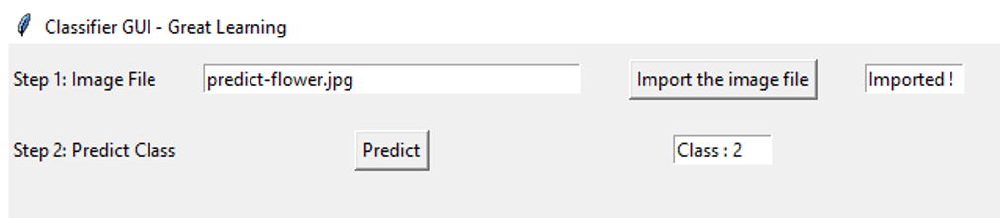

# ------------------------------------------------------------------------------------------------------------

# PART - FIVE

## Q) Explain in depth your strategy to maintain and support the AIML image classifier after it in production.

## Answer : 
## i) Scoring can't happen without training. So training setup will be expected to support discovering new features, do ultra-fast training with continuous or full learning as new data arrives - without OVERFITTING.
## ii) One should also make sure that the dependicies are taken care of especially when the trained models have been sent out to the data enginnering team. This can be taken care of using docker.
## iii) Models are expected to be scored with the best possible accuracies given the tradeoffs of training complexity and feature engineering involved - both real-time and batch.
## iv) Sometimes you can do training on all data, but the holy grail is for the models to learn continuously from new data that arrives, real time. Thus, shortening the time to deploy in production with the latest and greatest scoring artifacts - all without loosing the fidelity of the model is important.
## v) Batch scoring can be useful for image classifiers.

# ------------------------------------- THE END -------------------------------------------